# Numerical Optimization (CS215300) Assignment 2
## Introduction
In this assignment, we expect you to be familiar with the Pytorch optimizer library. We are using the Rosenbrock function as the benchmark of our optimization algorithms again. Since this is a simple test on very small scale, CUDA is not needed. You need to install Pytorch to acquire the pre-defined optimizers.  
The library document link: https://pytorch.org/docs/stable/optim.html

## Task
1. Please try different optimizers and observe the behavior of them, and try different hyperparameters and observe if they behave differently. (In case of L-BFGS, the parameters wrapped in this sample code won't work. If you want to try it anyway, you will need to write your own code.)
2. Whether if your setting converges or not, please justify it by experiment or your hyperthesis.
3. PLease answer the following question in your report:  
    (a) What is the relation between SGD and GD(gradient descent) in our case, i.e. when the input is one-dimensional?  
    (b) Have you found effective way to set hyperparameters so they can iterate faster toward the minimum point?
4. Please write a concise report about your experiments and analysis. If you need to plot tables, please check the following link: https://www.tablesgenerator.com/markdown_tables

##  Advanced Technique: Learning rate scheduler
Another technique to find hyperparameter for learning rate is to perform scheduled adjestments of learning rate. This is called 'learning rate scheduler'. The adjestments here not only affected by current learning rate and momentum etc., but also the epoch number or step numbers. Usually, in these kind of method, we are presuming the optimal hyperparameters can be found by recognizing certain patterns, and we schedule the experiments to search the proper parameters in such manner. You can also apply these function in your code. The library document of learning rate scheduler is in the same link above.



In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.optim as optim
from scipy.optimize import rosen, rosen_der, rosen_hess, fmin

In [2]:
def rosenbrock(tensor):
    # since pytorch uses tensor, we don't use built-in function here
    x, y = tensor
    return (1 - x) ** 2 + 100 * (y - x ** 2) ** 2

def Gradient_Descent(Grad, x, epsilon=0.00001, nMax = 10000):
    # TODO
    # Input arguments:
        # Grad: the derivative of the objective function
        # x: initial guess
        # epsilon: the tolerence of error during optimization, if error is less than epsilon we consider it as convergence
        # nMax: maxinum number of iteration, you can manually modify this constatnt if the default value is not enough
    # Output arguments:
        # x_iter: a list which contains new x for each step of iteration
        # step_length: a list which contains the optimal step length for each step of iteration
        # iter_count: an integer, the number of iteration the algorithm taken to convergence
        
    iter_count = 0
    x_current = x
    x_iter = []
    step_len = 0
    step_length = []
    # print(f"X INIT: {x}")

    def step_len_obj(t_, x_, dummy=0):
      return rosen(x_ - t_ * Grad(x_))
    def step_len_obj_der(x):
      return rosen(pos - x * Grad(pos)) @ rosen_der(pos)
    def step_len_constraint(t):
      return t
    def search_step_len(x, last_step_len):
      return np.clip(fmin(step_len_obj, 0, args=(x, 0), disp=0), a_min=0, a_max=1)

    while(iter_count <= nMax and (np.linalg.norm(Grad(x_current)) >= epsilon)):
      grad_current = Grad(x_current)
      hessian_current = rosen_hess(x_current)
      steep_descent_dir = -grad_current
      # step_len = - ((np.transpose(grad_current) @ steep_descent_dir)) / ((np.transpose(steep_descent_dir) @ hessian_current) @ steep_descent_dir)
      step_len = search_step_len(x_current, step_len)

      x_current = x_current + step_len * steep_descent_dir
      iter_count += 1
      # print(f"x_current: {x_current}")
      # print(f"hessian_current: {hessian_current}")
      # print(f"steep_descent_dir: {steep_descent_dir}")
      # print(f"step_len: {step_len}")
      # print(f"iter_count: {iter_count}")

      x_iter.append(x_current)
      step_length.append(step_len)

    return x_iter, iter_count, step_length

def gd_execute_steps(initial_state, num_iter=500):
    x_iter, iter_count, step_length = Gradient_Descent(Grad=rosen_der, x=initial_state, epsilon=0.00001, nMax=num_iter)
    return np.transpose(np.array(x_iter))

def execute_steps(func, initial_state, optimizer_class, optimizer_config, scheduler_class=None, scheduler_config=None, num_iter=500):
    x = torch.Tensor(initial_state).requires_grad_(True)
    optimizer = optimizer_class([x], **optimizer_config)
    if scheduler_class is not None:
      scheduler = scheduler_class(optimizer, **scheduler_config)
    steps = []
    steps = np.zeros((2, num_iter))
    steps[:, 0] = np.array(initial_state)
    last_f = torch.tensor([100., 100.])
    for i in range(0, num_iter):
        optimizer.zero_grad()
        f = func(x)
        f.backward(create_graph=True, retain_graph=True)
        torch.nn.utils.clip_grad_norm_(x, 1.0)
        optimizer.step()
        if scheduler_class is not None:
          scheduler.step()
        steps[:, i] = x.detach().numpy()
    return steps

def execute_steps_closure(func, initial_state, optimizer_class, optimizer_config, scheduler_class=None, scheduler_config=None, num_iter=500):
    x = torch.Tensor(initial_state).requires_grad_(True)
    optimizer = optimizer_class([x], **optimizer_config)
    if scheduler_class is not None:
      scheduler = scheduler_class(optimizer, **scheduler_config)
    steps = []
    steps = np.zeros((2, num_iter))
    steps[:, 0] = np.array(initial_state)
    last_f = torch.tensor([100., 100.])
    for i in range(0, num_iter):
        def closure():
          optimizer.zero_grad()
          f = func(x)
          f.backward(create_graph=True, retain_graph=True)
          # torch.nn.utils.clip_grad_norm_(x, 1.0)
          return f
        optimizer.step(closure)
        if scheduler_class is not None:
          scheduler.step()
        steps[:, i] = x.detach().numpy()
    return steps

def plot_rosenbrok(grad_iter, optimizer_name):
    x = np.linspace(-2, 2, 250)
    y = np.linspace(-1, 3, 250)
    minimum = (1.0, 1.0)

    X, Y = np.meshgrid(x, y)
    Z = rosenbrock([X, Y])

    iter_x, iter_y = grad_iter[0, :], grad_iter[1, :]

    fig = plt.figure(figsize=(8, 8))

    ax = fig.add_subplot(1, 1, 1)
    ax.contour(X, Y, Z, 90, cmap='jet')
    ax.plot(iter_x, iter_y, color='r', marker='x')

    ax.set_title('{} with {} iterations'.format(optimizer_name, len(iter_x)))
    plt.plot(*minimum, 'gD')
    plt.plot(iter_x[-1], iter_y[-1], 'rD')
    plt.show()

In [3]:
def draw_step_len(step_length):
  plt.figure(figsize=(16,9))
  plt.plot(step_length)
  plt.title('Step Length')
  plt.xlabel('epoch')
  plt.ylabel('step length')
  plt.show()

def compute_step_len(x_iter):
  x_last = x_iter[:, 0]
  step_lengths = []

  for i in range(x_iter[:, 1:].shape[1]):
    x = x_iter[:, i]
    norm = np.linalg.norm(x - x_last)
    x_last = x
    step_lengths.append(norm)
  return step_lengths

def printX(steps):
    iter_x, iter_y = steps[0, :], steps[1, :]
    i=0
    for x,y in zip(iter_x,iter_y):
        print("iteration %d: [%.4f %.4f]" %(i,x,y))
        i+=1

def visualize(x_iter):
    x0_iter = np.array([i[0] for i in x_iter])
    x1_iter = np.array([i[1] for i in x_iter])
    x = np.linspace(-3,3,1000)
    y = np.linspace(-1,6,1000)
    X, Y = np.meshgrid(x, y)
    Z = rosen([X,Y])

    anglesx = x0_iter[1:] - x0_iter[:-1]
    anglesy = x1_iter[1:] - x1_iter[:-1]

    %matplotlib inline
    fig, ax = plt.subplots(figsize=(16,9))
    CS = ax.contour(X, Y, Z, 50, cmap = 'jet')
    ax.set_title('Contour')
    for i in x_iter:
        ax.scatter(i[0],i[1],color = 'r', marker = '.')

    for i in range(len(x_iter)-1):
        ax.quiver(x_iter[i][0], x_iter[i][1], anglesx[i], anglesy[i], scale_units = 'xy', angles = 'xy', scale = 1, color = 'r', alpha = .3)

    plt.show()

In [4]:
initial_state = np.array([-2,2])
tol=1e-2

# GD

(2, 501)


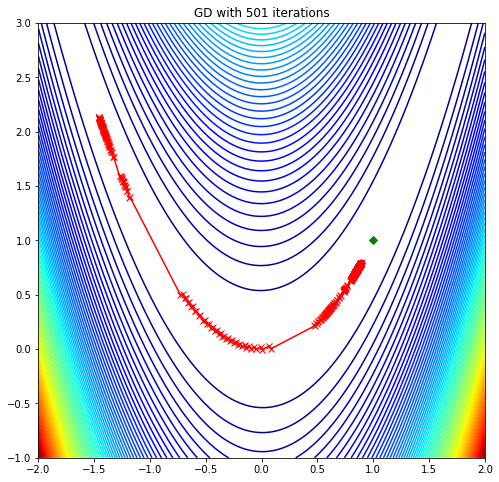

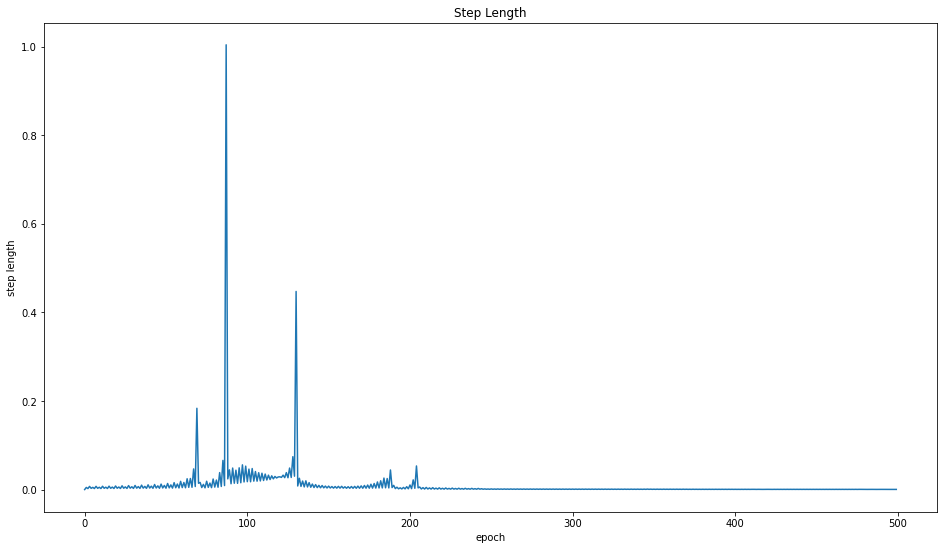

In [5]:
steps = gd_execute_steps(initial_state=initial_state)
print(f"{steps.shape}")
plot_rosenbrok(steps, 'GD')
# visualize(steps)
draw_step_len(compute_step_len(steps))

# SGD

LR: 0.01 | momentum: 0.1 | weight_decay: 0.01


/usr/local/lib/python3.7/dist-packages/torch/autograd/__init__.py:156: UserWarning: Using backward() with create_graph=True will create a reference cycle between the parameter and its gradient which can cause a memory leak. We recommend using autograd.grad when creating the graph to avoid this. If you have to use this function, make sure to reset the .grad fields of your parameters to None after use to break the cycle and avoid the leak. (Triggered internally at  ../torch/csrc/autograd/engine.cpp:976.)
  allow_unreachable=True, accumulate_grad=True)  # allow_unreachable flag


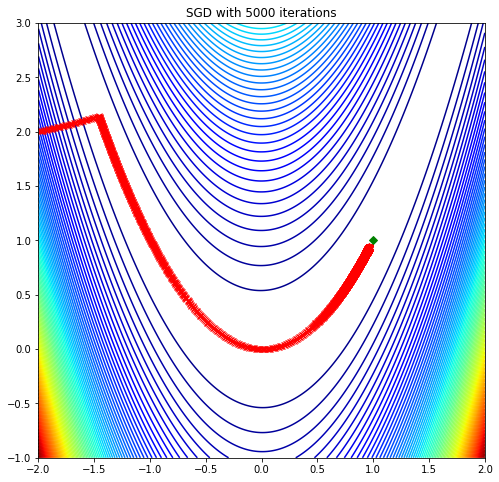

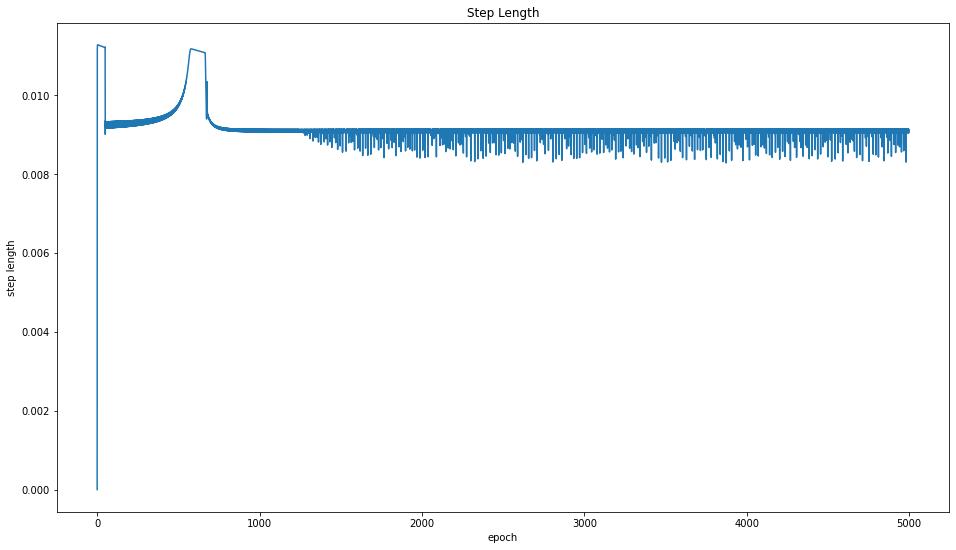

LR: 0.01 | momentum: 0.1 | weight_decay: 0.001


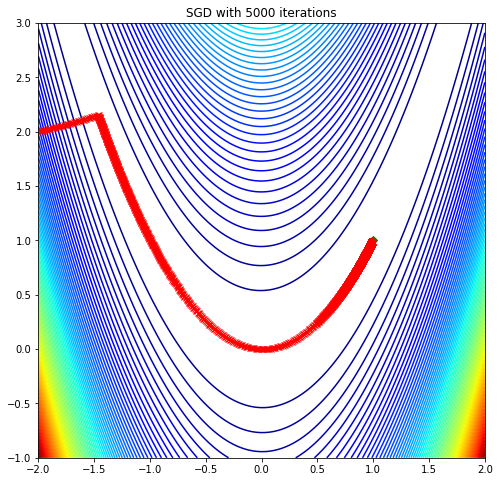

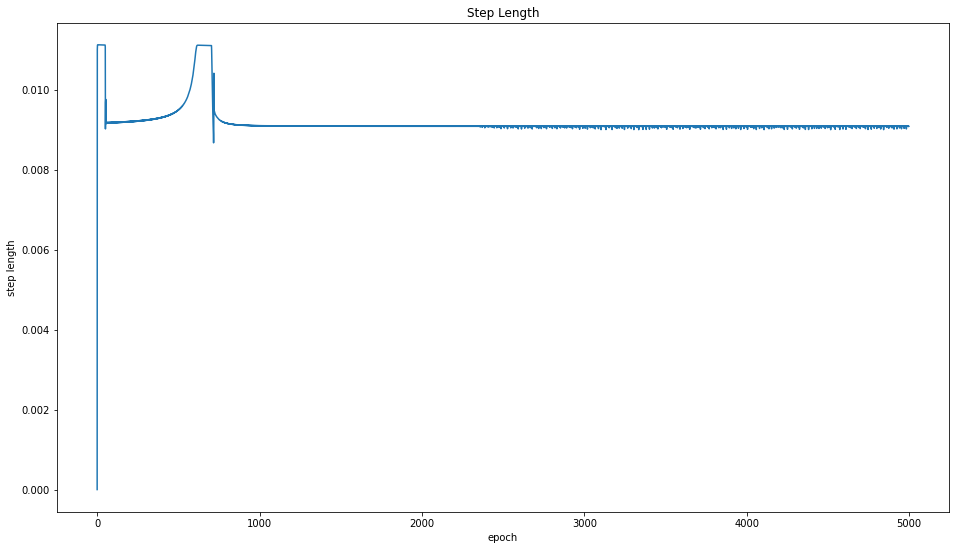

LR: 0.01 | momentum: 0.5 | weight_decay: 0.01


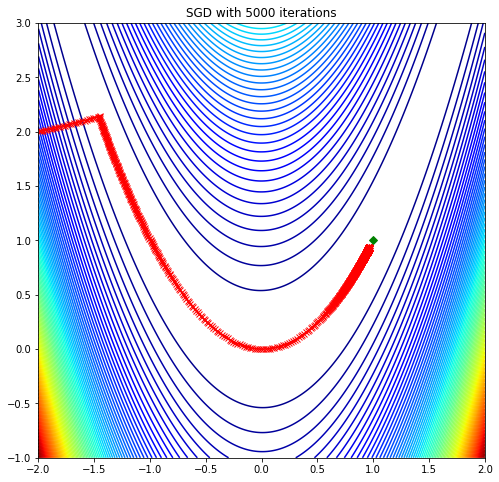

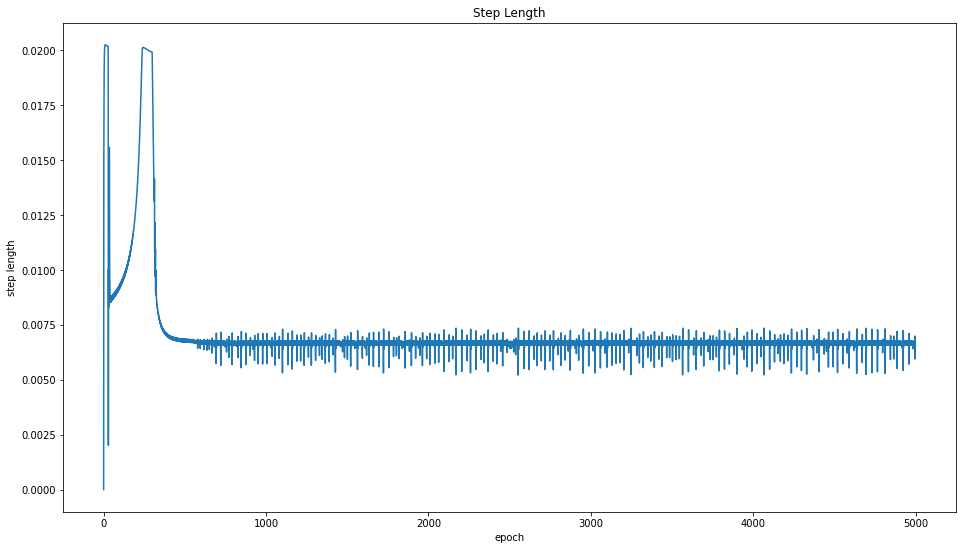

LR: 0.01 | momentum: 0.5 | weight_decay: 0.001


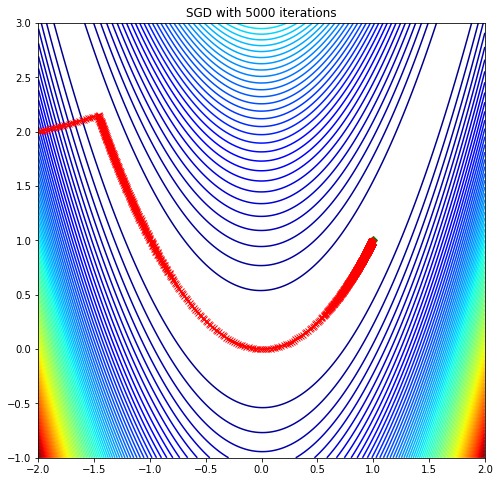

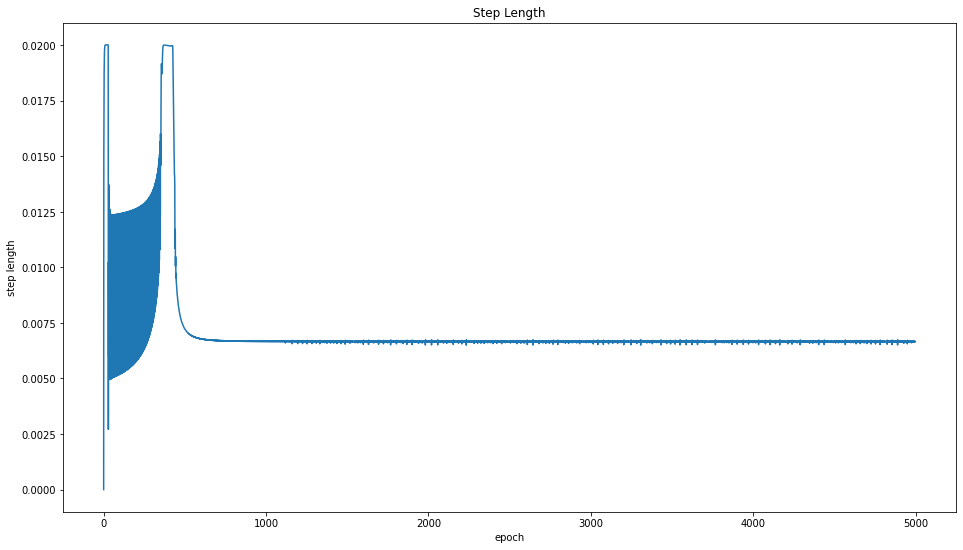

LR: 0.1 | momentum: 0.1 | weight_decay: 0.01


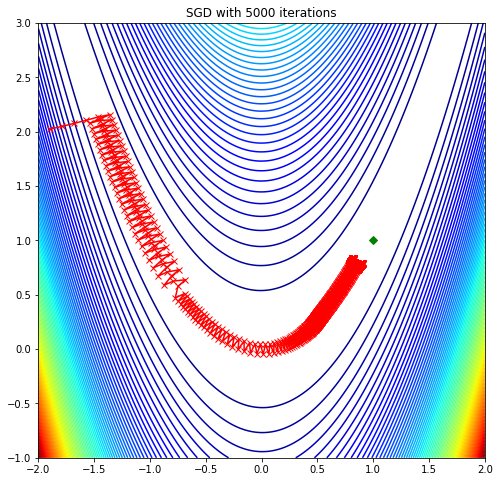

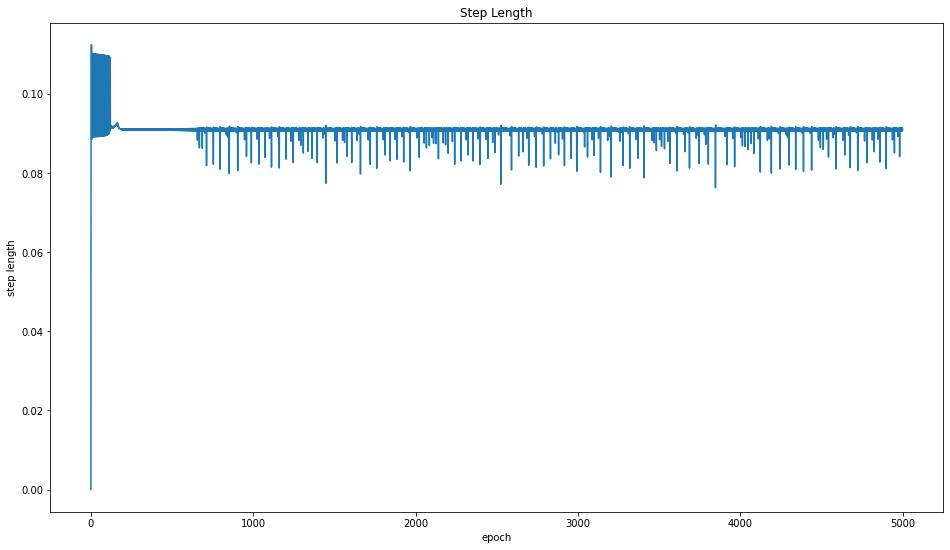

LR: 0.1 | momentum: 0.1 | weight_decay: 0.001


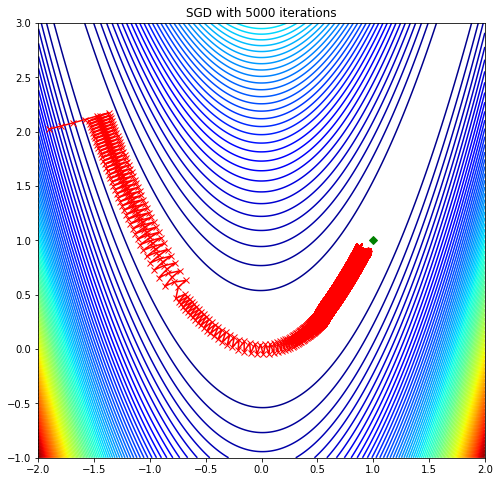

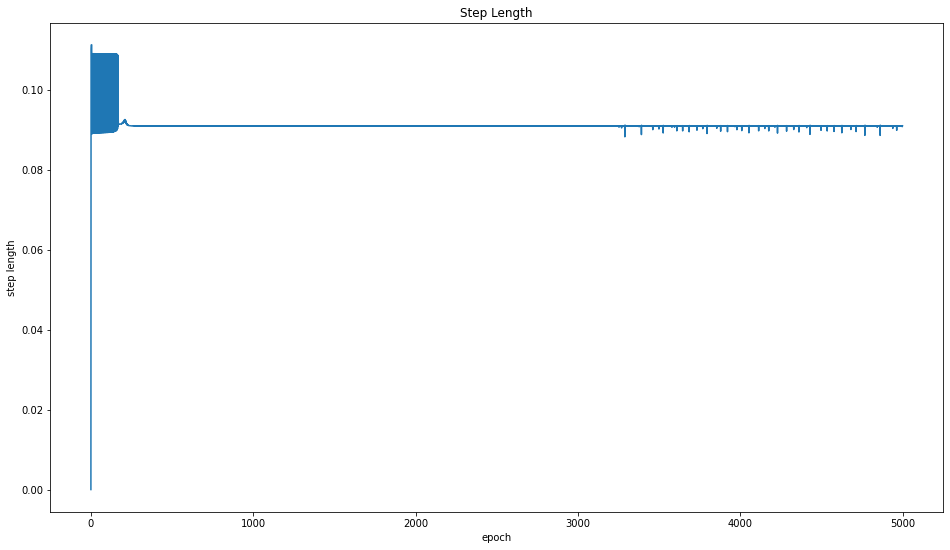

LR: 0.1 | momentum: 0.5 | weight_decay: 0.01


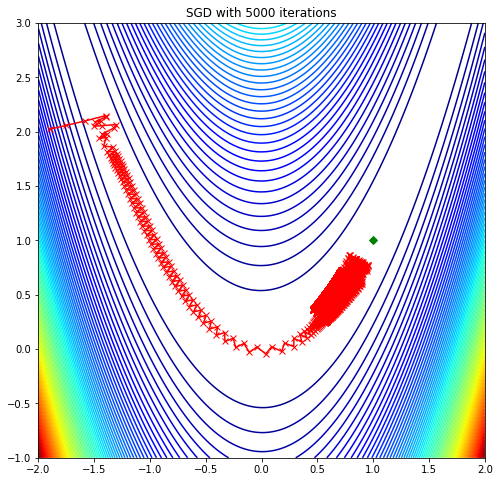

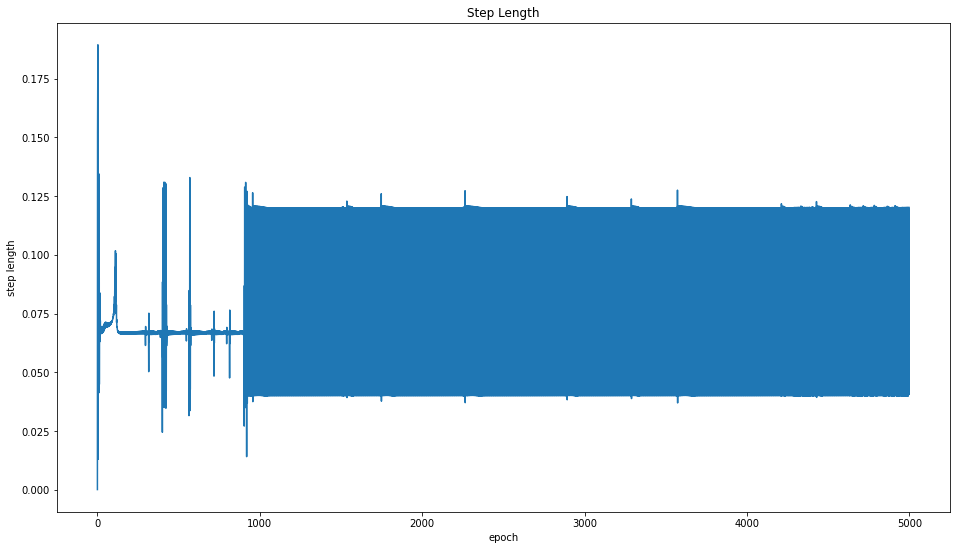

LR: 0.1 | momentum: 0.5 | weight_decay: 0.001


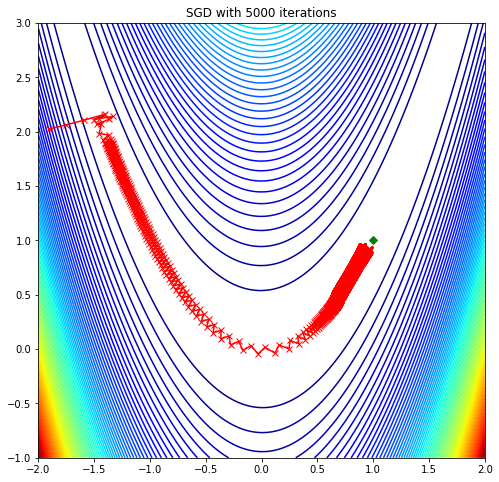

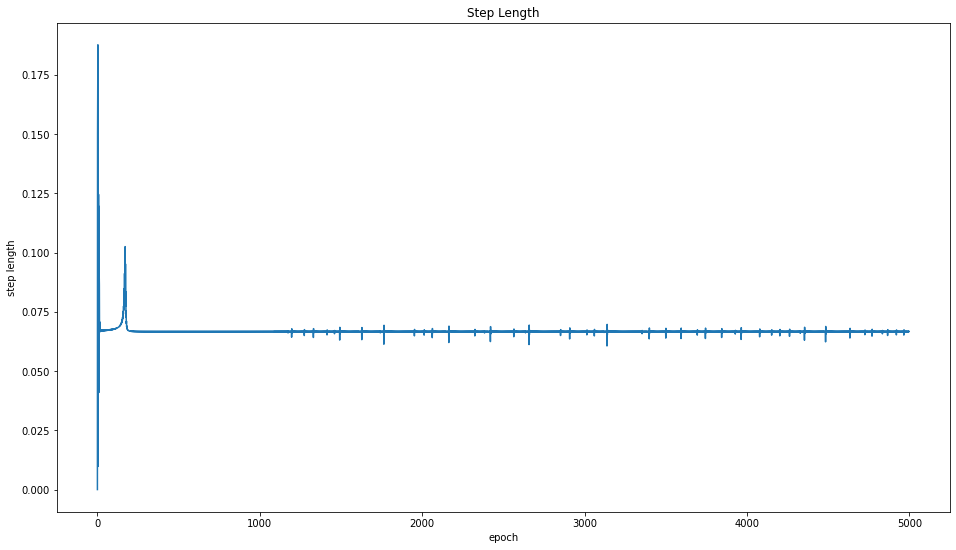

LR: 0.5 | momentum: 0.1 | weight_decay: 0.01


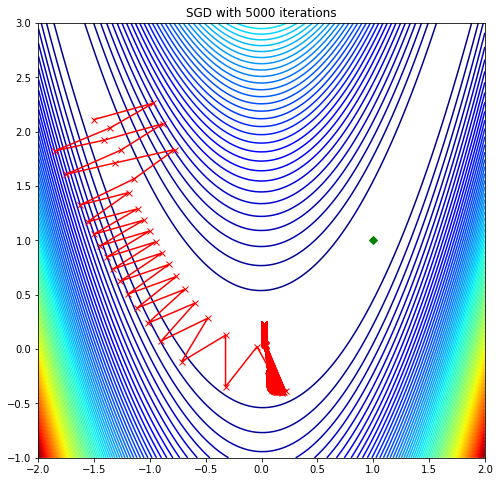

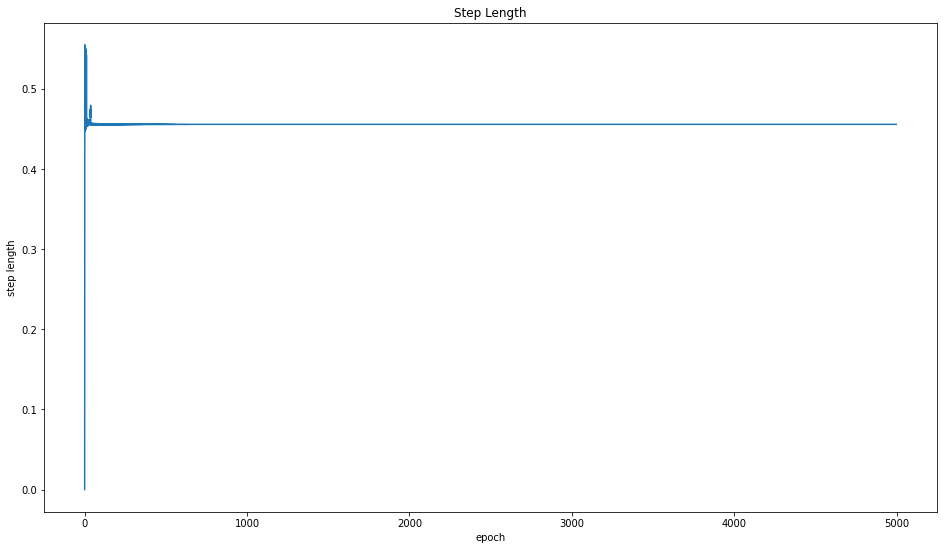

LR: 0.5 | momentum: 0.1 | weight_decay: 0.001


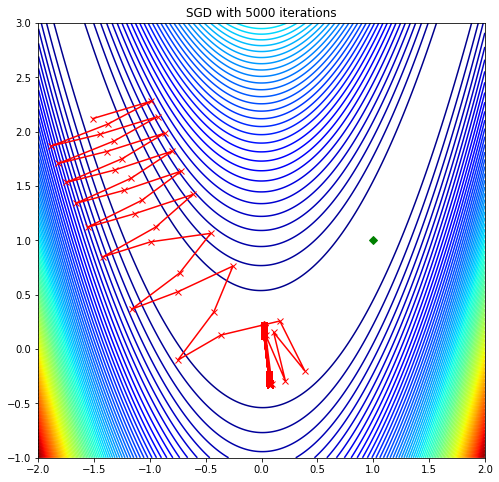

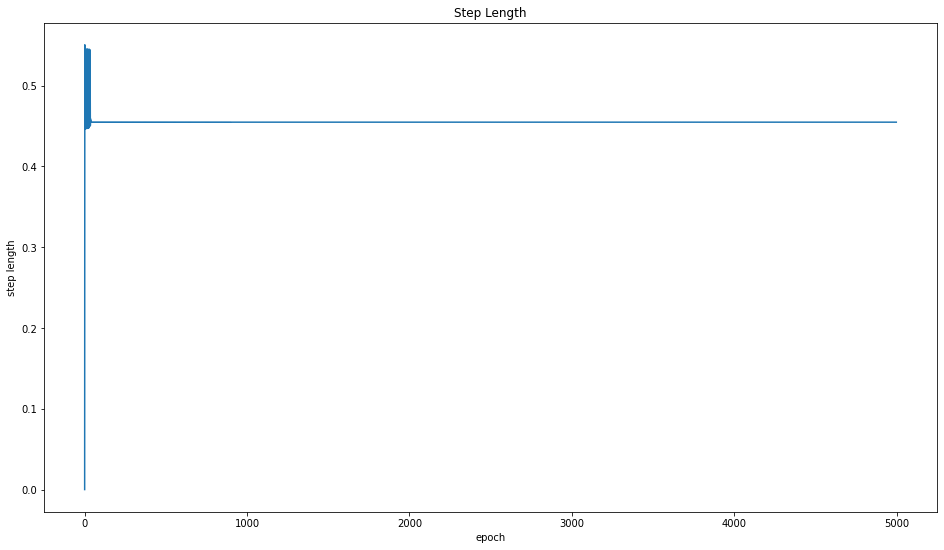

LR: 0.5 | momentum: 0.5 | weight_decay: 0.01


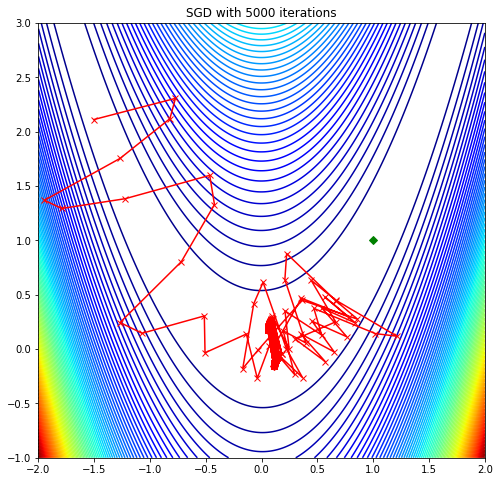

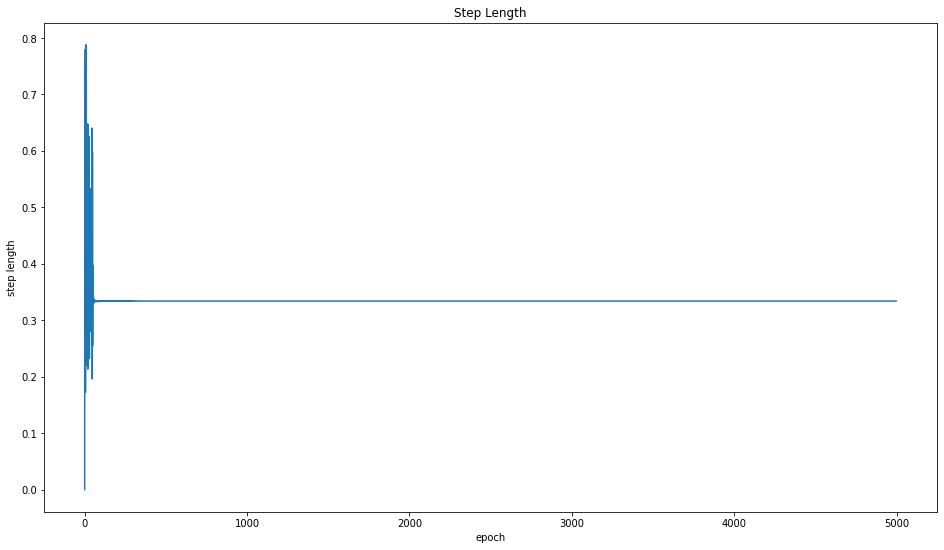

LR: 0.5 | momentum: 0.5 | weight_decay: 0.001


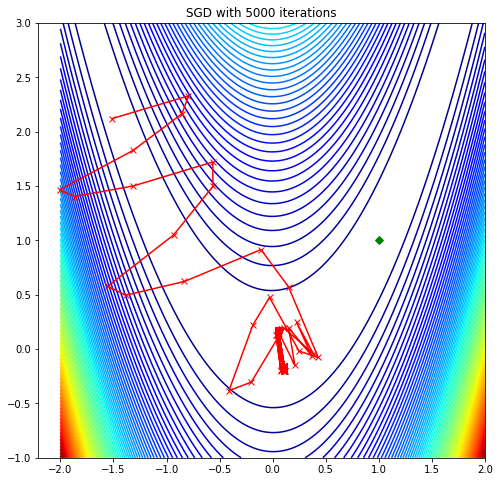

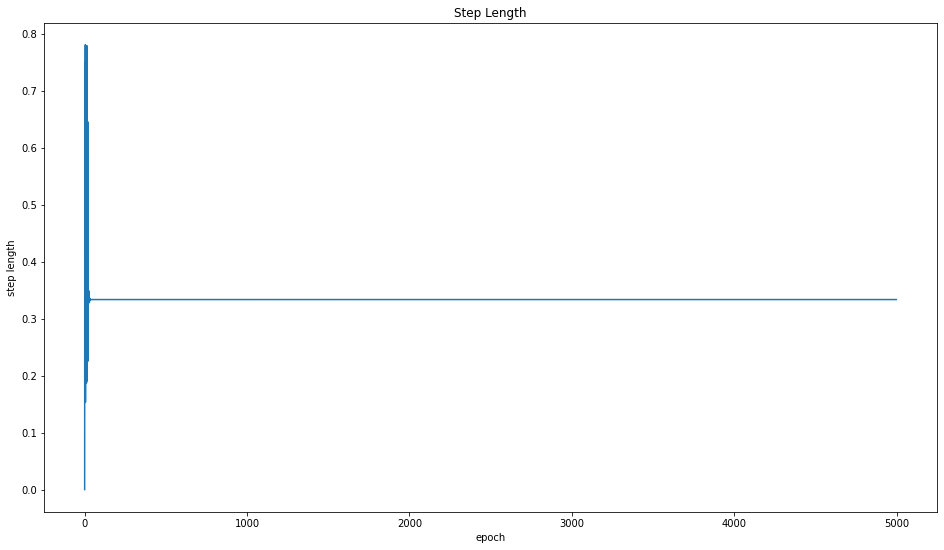

LR: 1 | momentum: 0.1 | weight_decay: 0.01


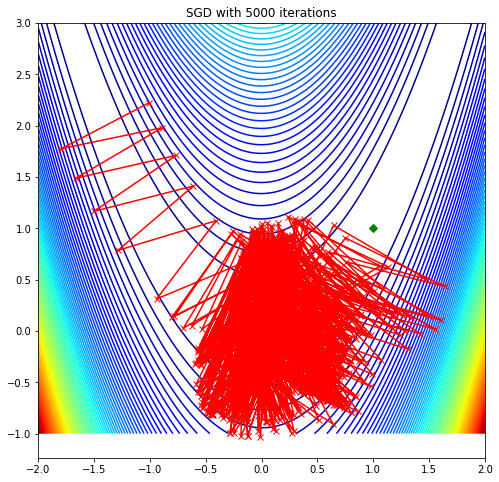

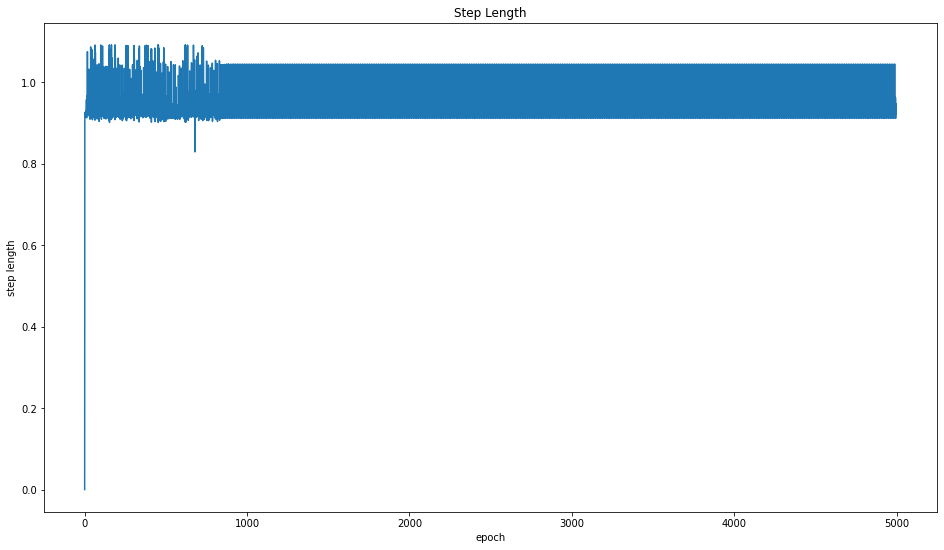

LR: 1 | momentum: 0.1 | weight_decay: 0.001


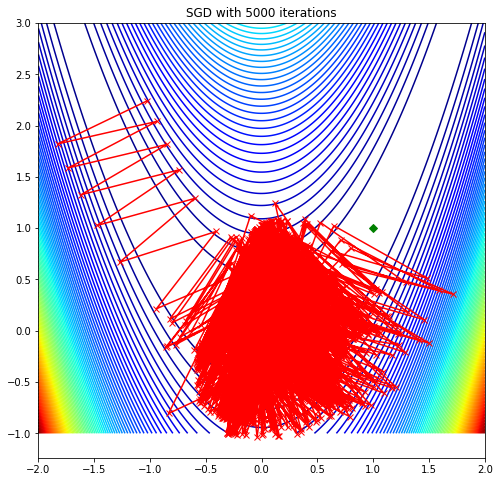

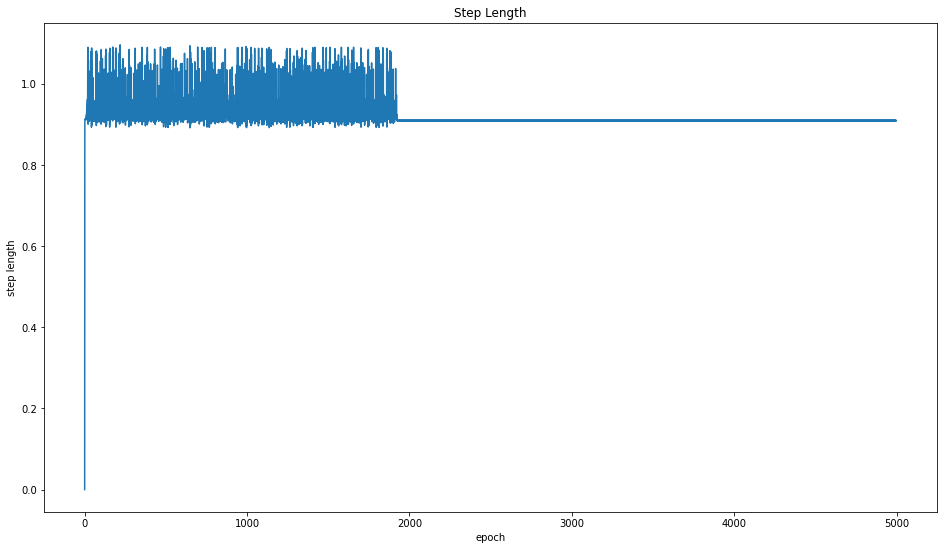

LR: 1 | momentum: 0.5 | weight_decay: 0.01


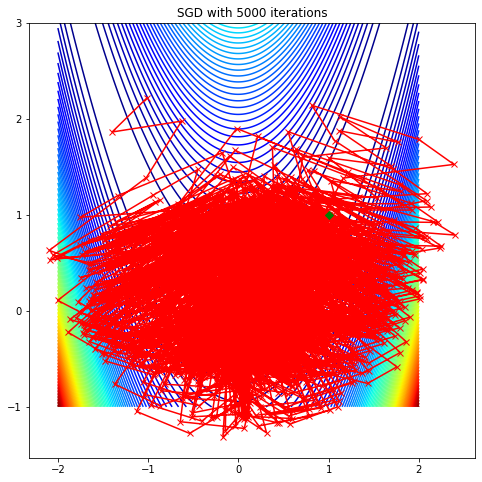

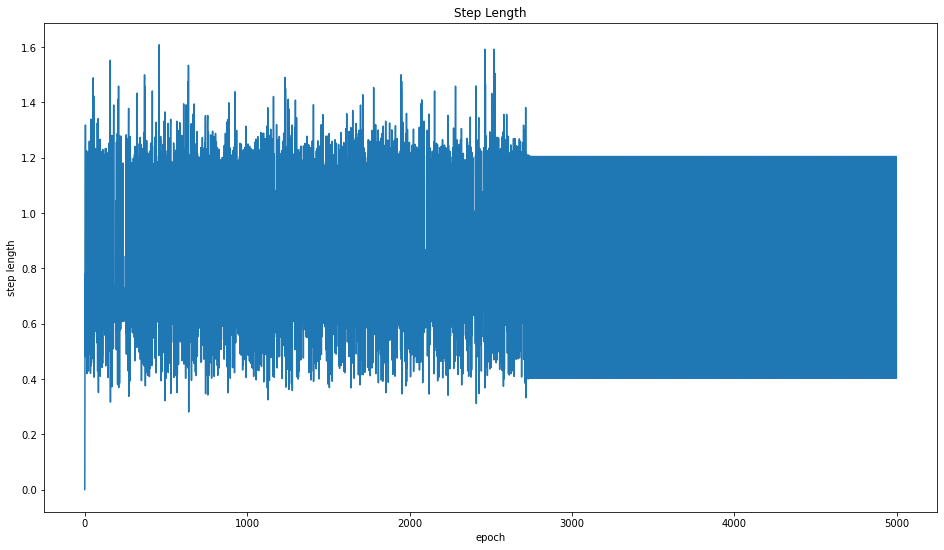

LR: 1 | momentum: 0.5 | weight_decay: 0.001


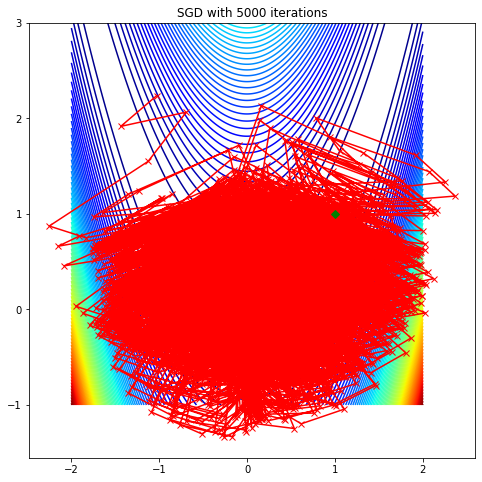

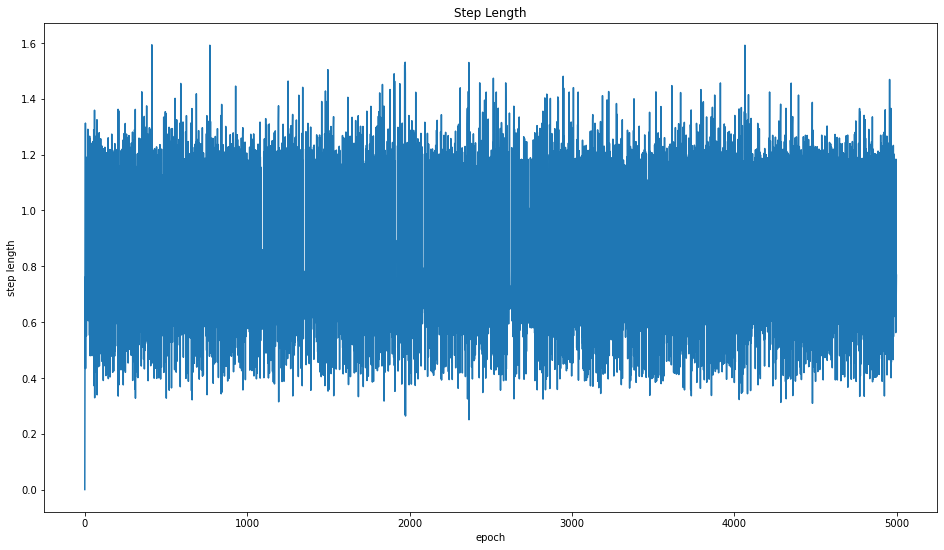

In [6]:
# Try other optimizers!
optimizer_class = torch.optim.SGD
for lr in [0.01, 0.1, 0.5, 1]:
  for momentum in [0.1, 0.5]:
    for weight_decay in [0.01, 0.001]:
      print(f"LR: {lr} | momentum: {momentum} | weight_decay: {weight_decay}")
      steps = execute_steps(
              rosenbrock,
              initial_state,
              optimizer_class,
              # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
              {'lr':lr, 'momentum':momentum, 'weight_decay':weight_decay},
              num_iter=5000,
          )
      plot_rosenbrok(steps, optimizer_class.__name__)
      # print(f"{steps.shape}")
      draw_step_len(compute_step_len(steps))

# LBFGS

LR: 0.001


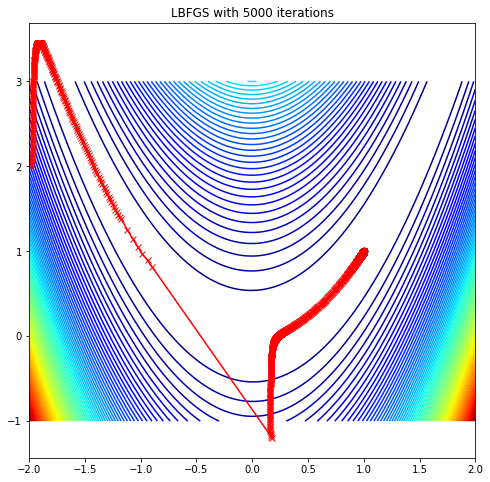

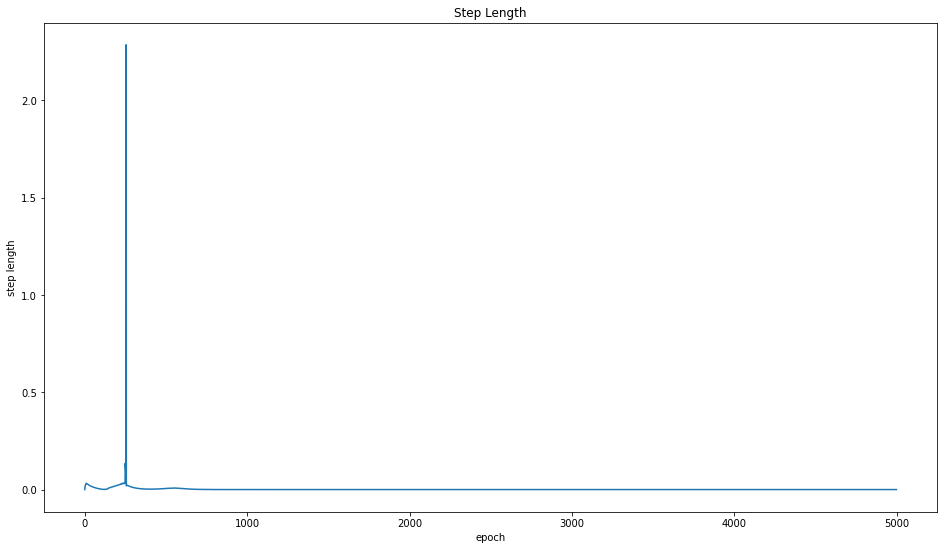

LR: 0.01


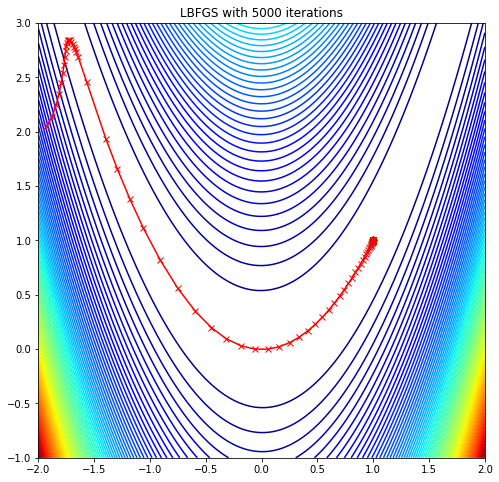

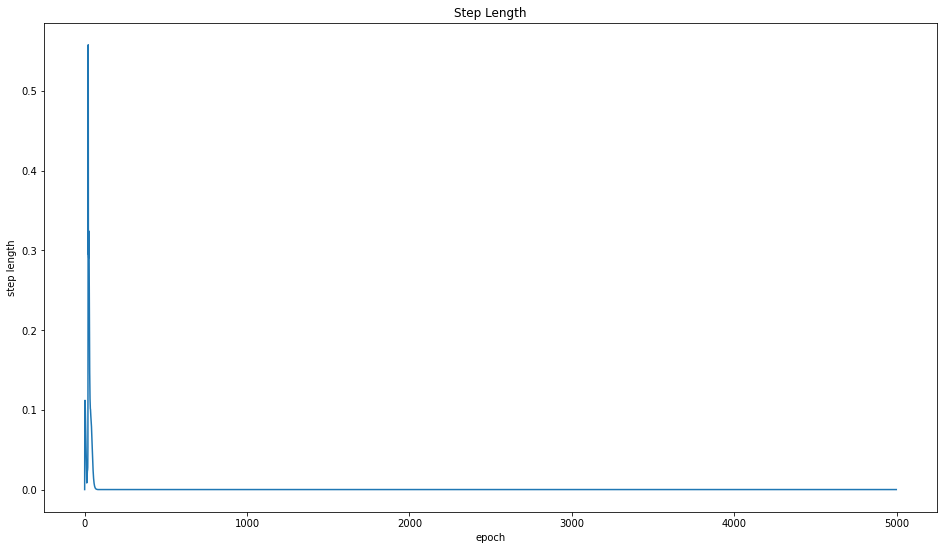

LR: 0.1


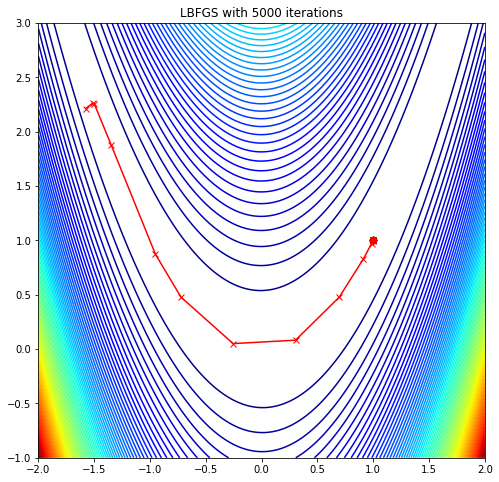

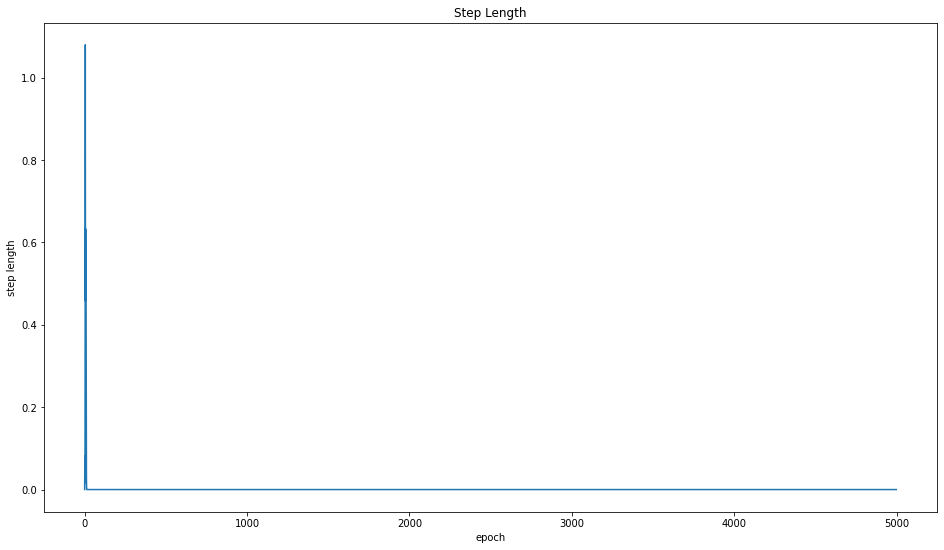

LR: 1


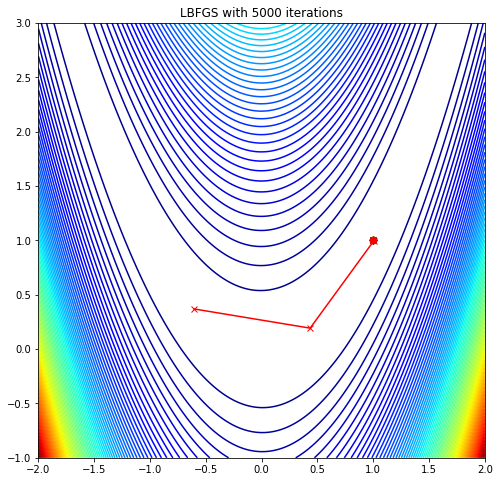

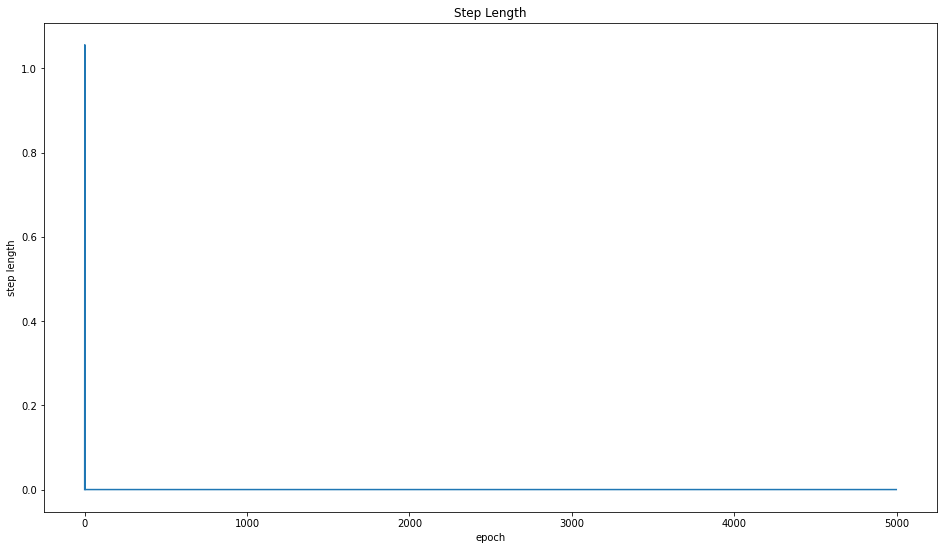

In [7]:
# Try other optimizers!
optimizer_class = torch.optim.LBFGS
for lr in [0.001, 0.01, 0.1, 1]:
  print(f"LR: {lr}")
  steps = execute_steps_closure(
          rosenbrock,
          initial_state,
          optimizer_class,
          # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
          {'lr':lr},
          num_iter=5000,
      )
  plot_rosenbrok(steps, optimizer_class.__name__)
  draw_step_len(compute_step_len(steps))

# AdaGrad

Adaptive learning rate

$$
r^{(t+1)} \leftarrow r^{(t)} + g^{(t)} \odot g^{(t)}
$$

$$
\Theta^{(t+1)} \leftarrow \Theta^{(t)} − \frac{\eta}{\sqrt{r^{(t+1)}}} g^{(t)}
$$

LR: 0.01 | lr_decay: 0 | weight_decay: 0.01


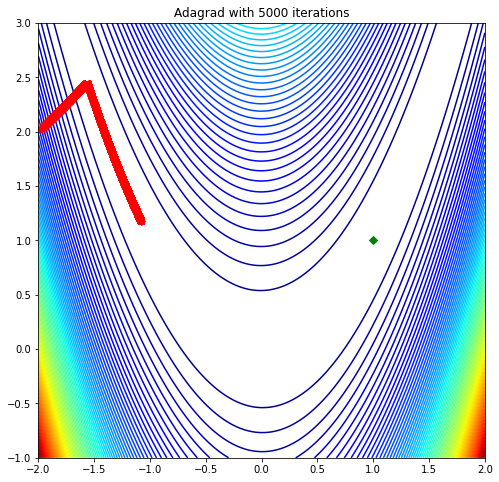

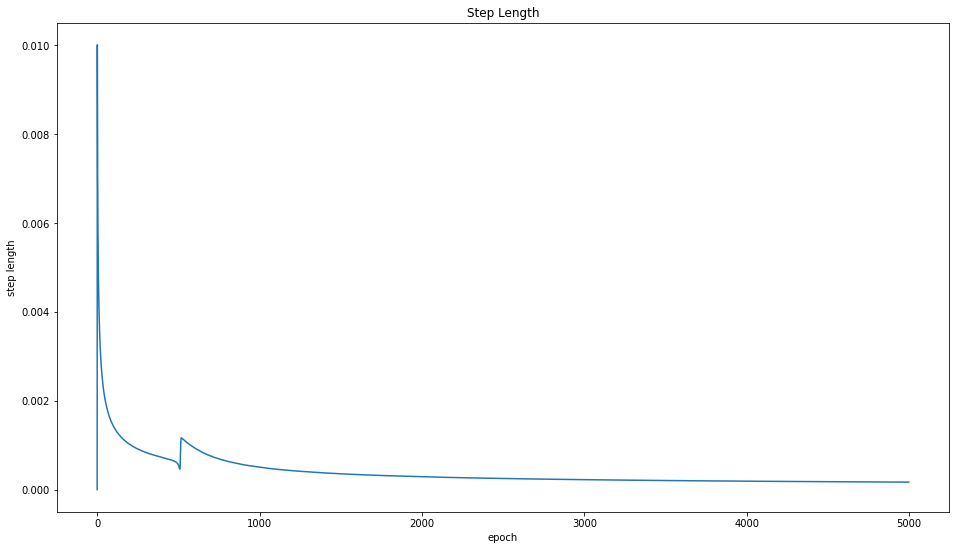

LR: 0.01 | lr_decay: 0 | weight_decay: 0.001


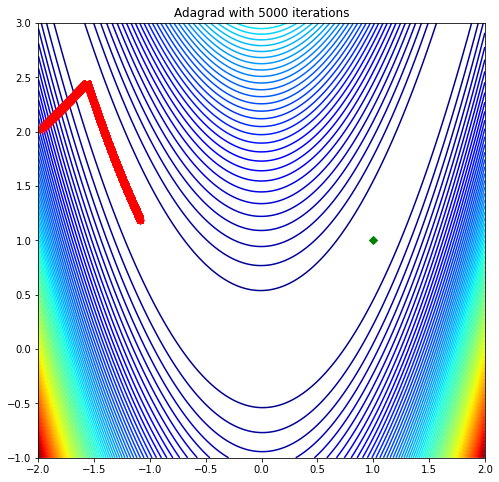

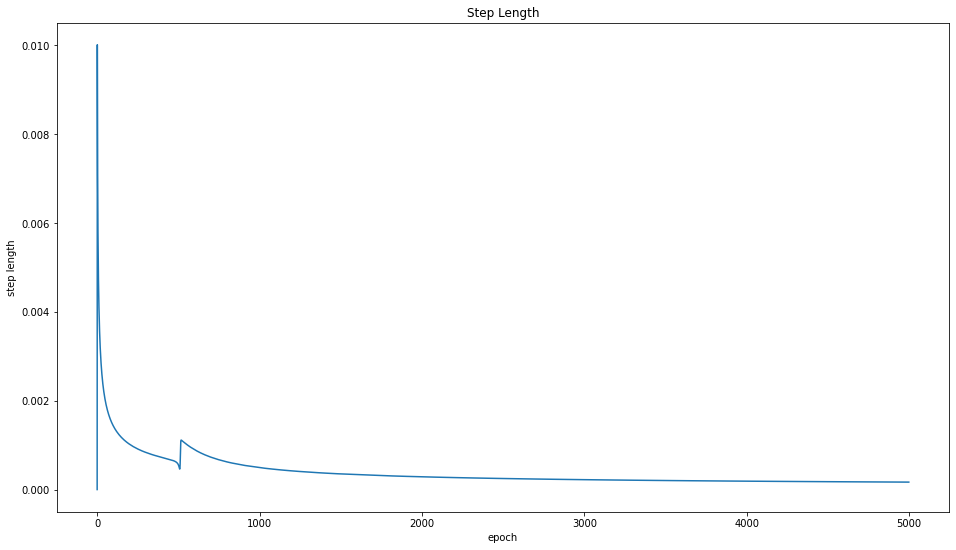

LR: 0.1 | lr_decay: 0 | weight_decay: 0.01


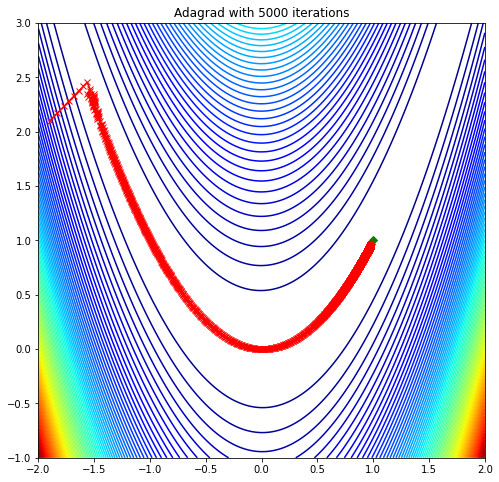

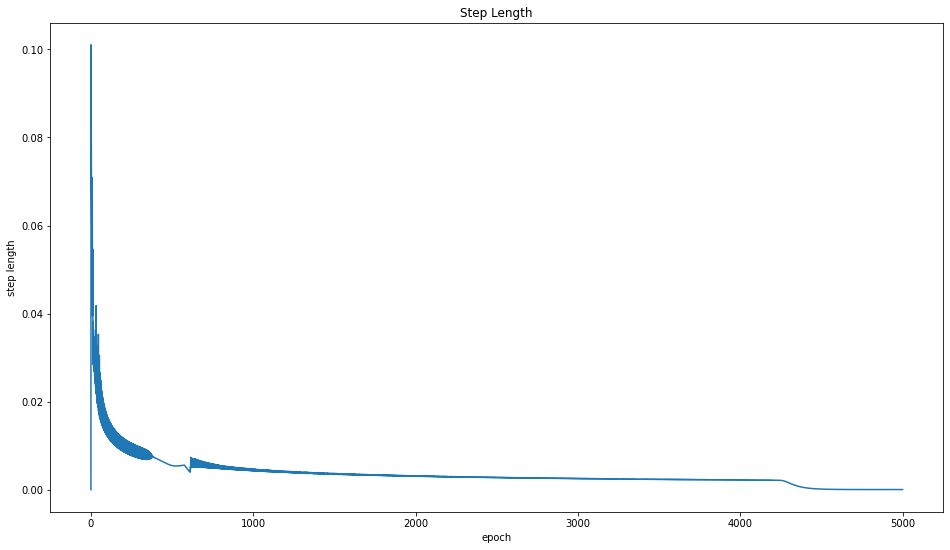

LR: 0.1 | lr_decay: 0 | weight_decay: 0.001


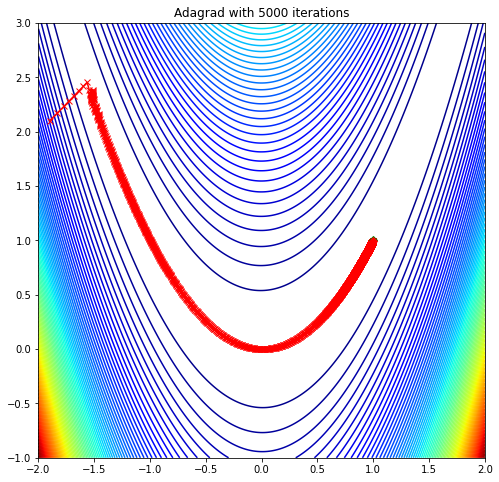

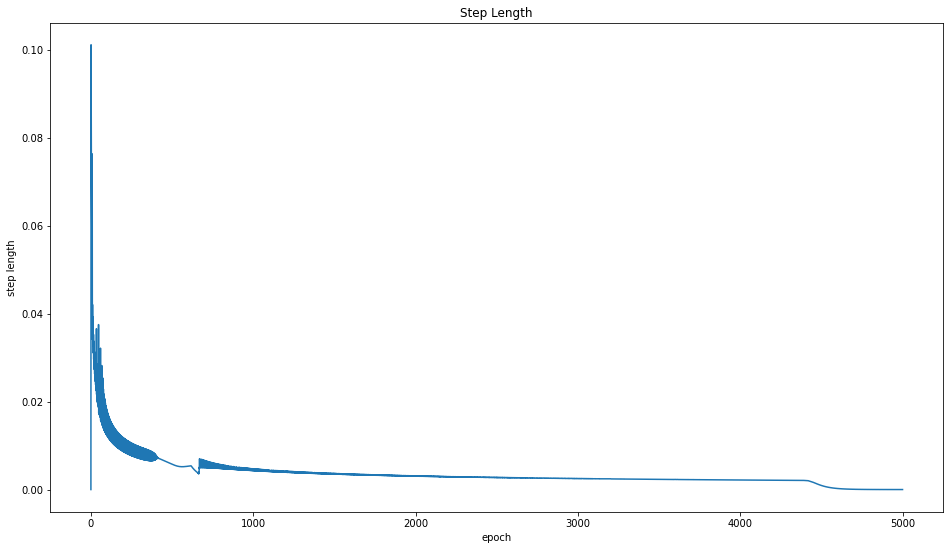

LR: 0.5 | lr_decay: 0 | weight_decay: 0.01


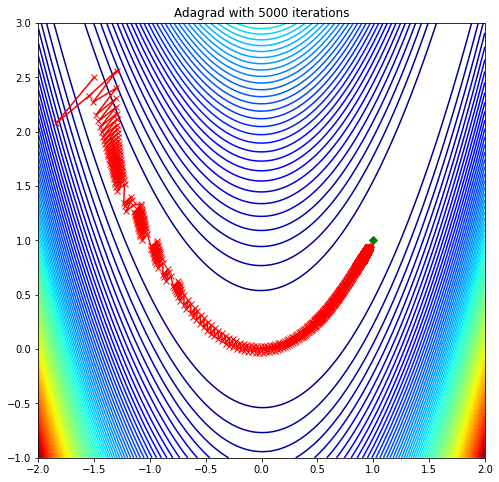

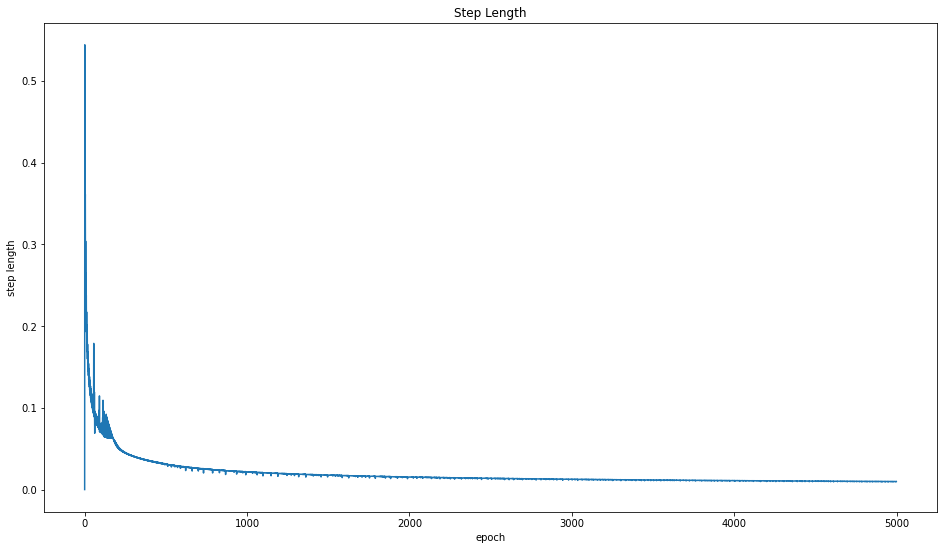

LR: 0.5 | lr_decay: 0 | weight_decay: 0.001


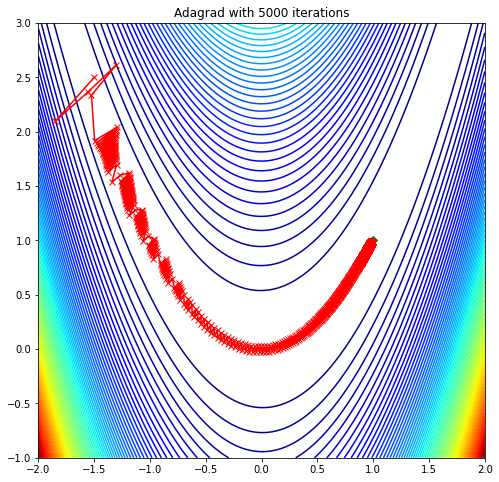

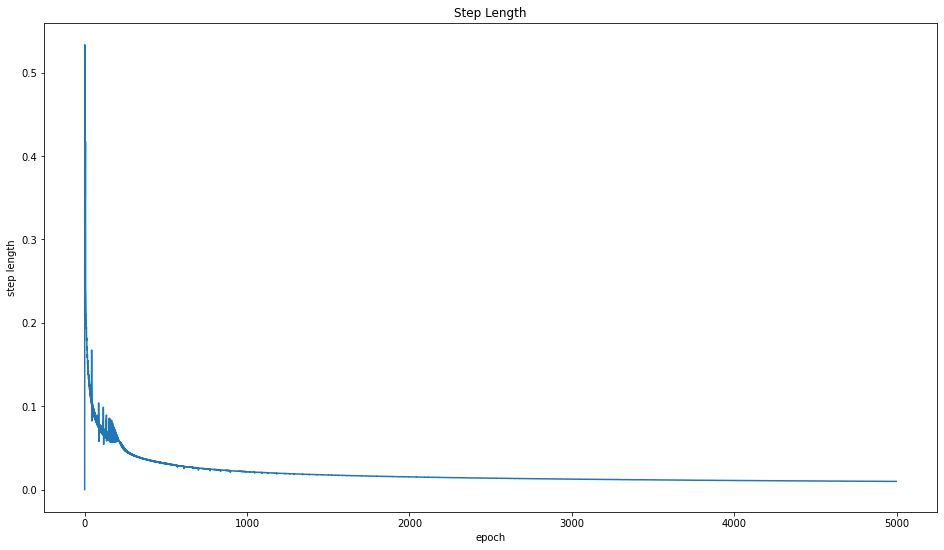

LR: 1 | lr_decay: 0 | weight_decay: 0.01


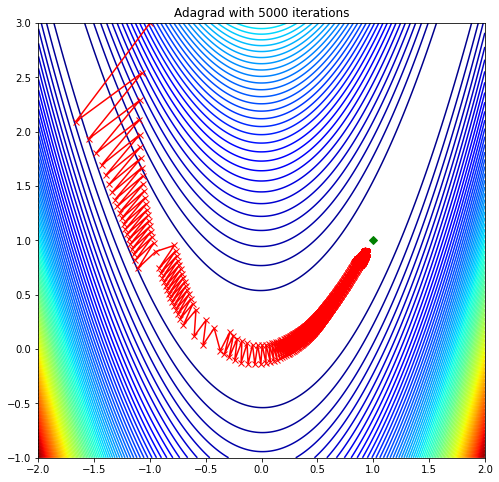

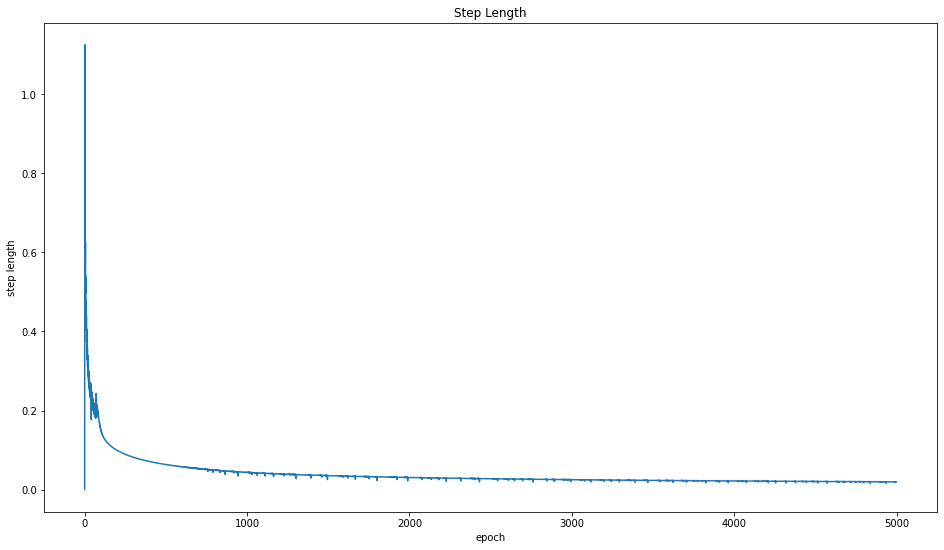

LR: 1 | lr_decay: 0 | weight_decay: 0.001


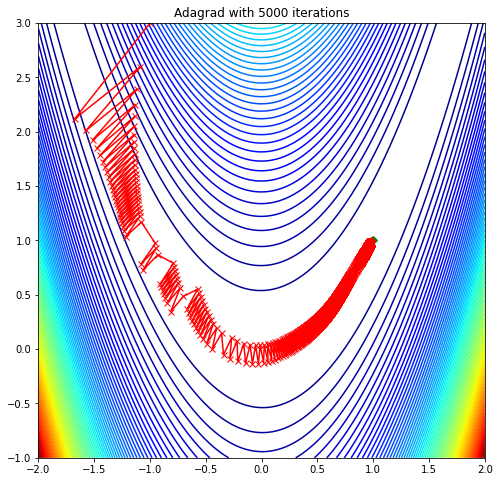

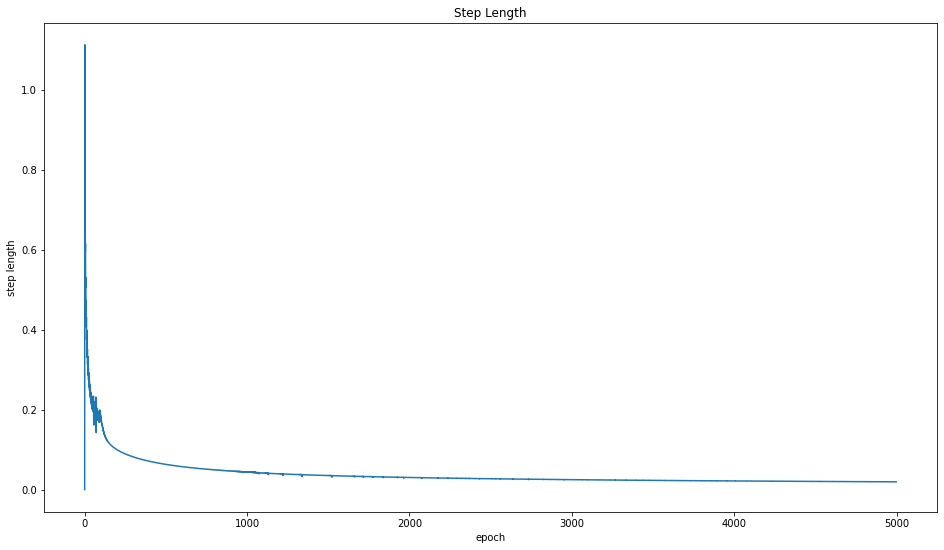

In [8]:
# Try other optimizers!
optimizer_class = torch.optim.Adagrad
for lr in [0.01, 0.1, 0.5, 1]:
  for lr_decay in [0]:
    for weight_decay in [0.01, 0.001]:
      print(f"LR: {lr} | lr_decay: {lr_decay} | weight_decay: {weight_decay}")
      steps = execute_steps(
              rosenbrock,
              initial_state,
              optimizer_class,
              # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
              {'lr': lr, 'lr_decay': lr_decay, 'weight_decay': weight_decay, 'initial_accumulator_value': 0, 'eps': 1e-10},
              num_iter=5000,
          )
      plot_rosenbrok(steps, optimizer_class.__name__)
      draw_step_len(compute_step_len(steps))

# RMSProp

Moving average adaptive learning rate

$$
r^{(t+1)} \leftarrow \lambda r^{(t)} + (1 − \lambda) g^{(t)} \odot g^{(t)}
$$

$$
\Theta^{(t+1)} \leftarrow \Theta^{(t)} − \frac{\eta}{\sqrt{r^{(t+1)}}} g^{(t)}
$$

LR: 0.01 | momentum: 0 | weight_decay: 0.01


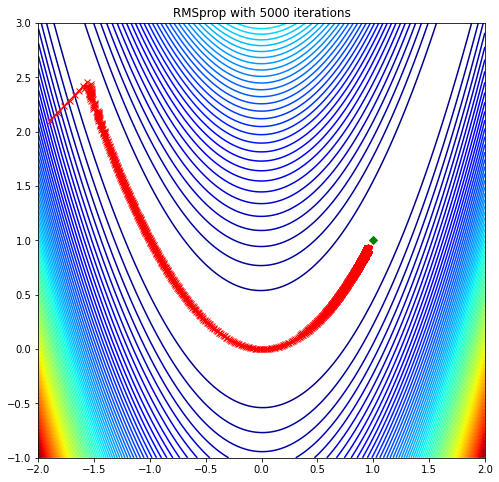

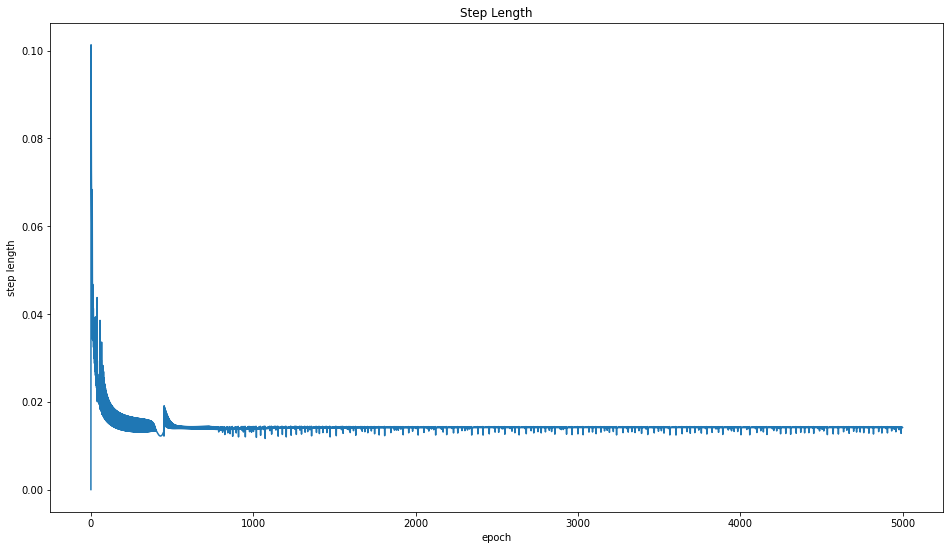

LR: 0.01 | momentum: 0 | weight_decay: 0.001


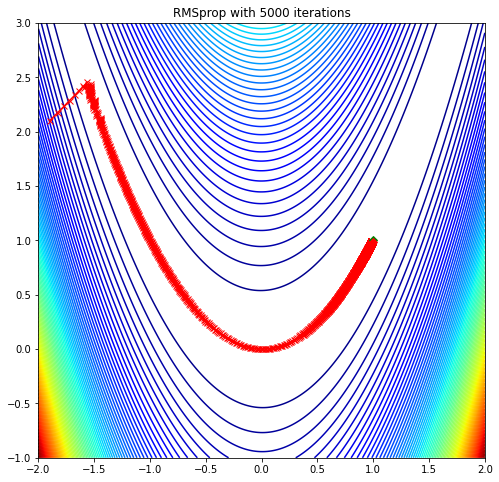

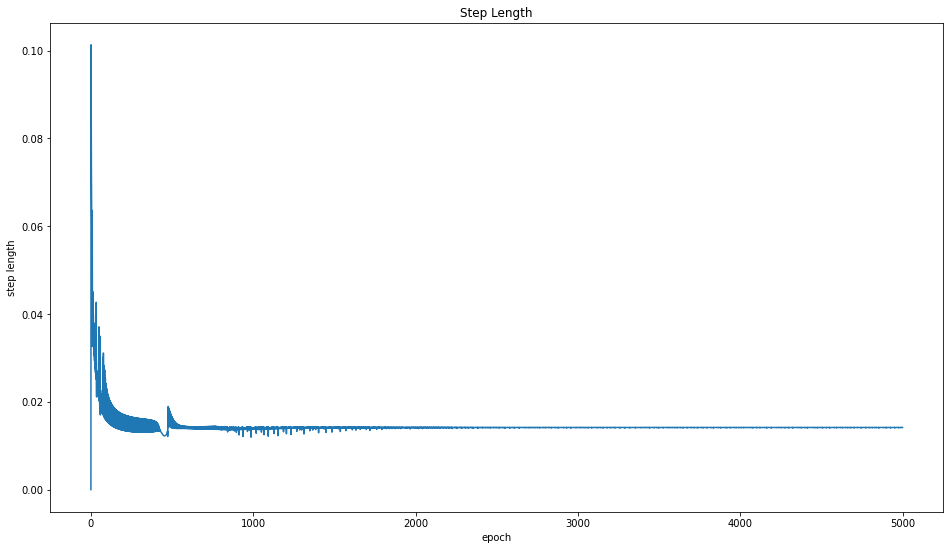

LR: 0.1 | momentum: 0 | weight_decay: 0.01


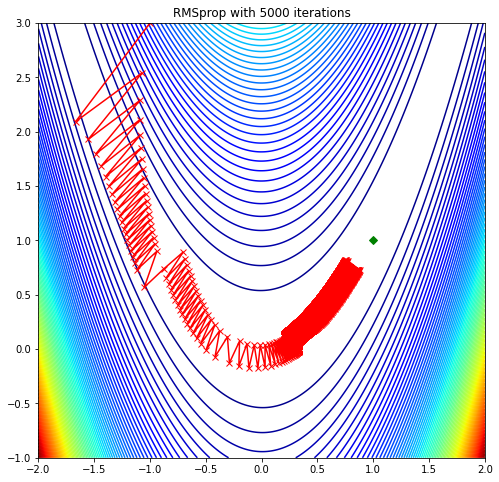

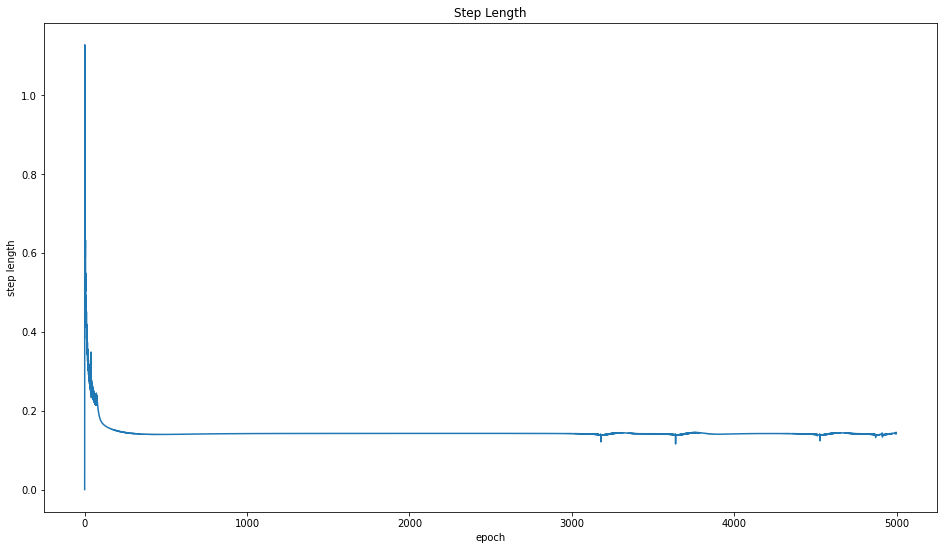

LR: 0.1 | momentum: 0 | weight_decay: 0.001


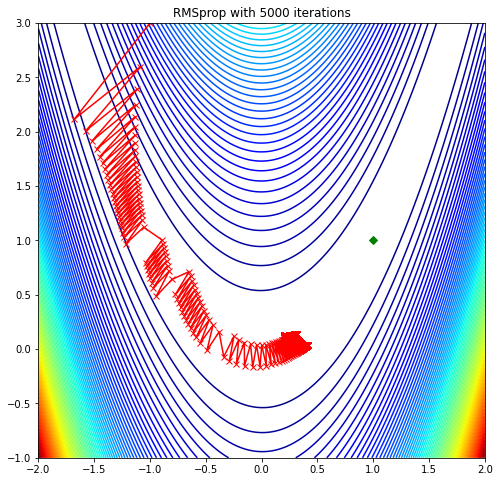

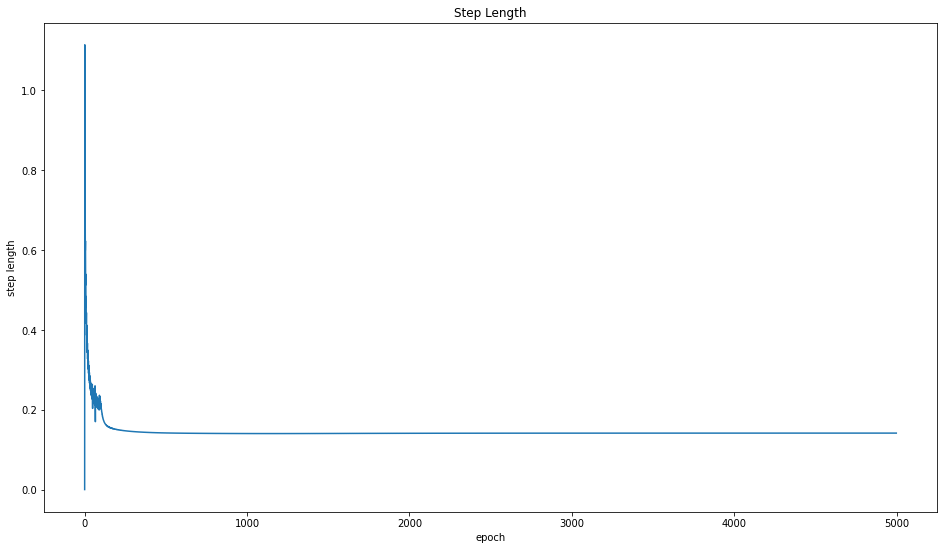

In [9]:
# Try other optimizers!
optimizer_class = torch.optim.RMSprop
for lr in [0.01, 0.1]:
  for momentum in [0]:
    for weight_decay in [0.01, 0.001]:
      print(f"LR: {lr} | momentum: {momentum} | weight_decay: {weight_decay}")
      steps = execute_steps(
              rosenbrock,
              initial_state,
              optimizer_class,
              # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
              {'lr': lr, 'alpha': 0.99, 'eps': 1e-08, 'weight_decay': weight_decay, 'momentum': momentum, 'centered': False},
              num_iter=5000,
          )
      plot_rosenbrok(steps, optimizer_class.__name__)
      draw_step_len(compute_step_len(steps))

# ADAM

Moving average adaptive learning rate + momentum

$$
v^{(t+1)} \leftarrow \lambda_1 v^{(t)} − (1 − \lambda_1) g^{(t)}
$$

$$
r^{(t+1)} \leftarrow \lambda_2 r^{(t)} + (1 − \lambda_2) g^{(t)} \odot g^{(t)}
$$

$$
\Theta^{(t+1)} \leftarrow \Theta^{(t)} − \frac{\eta}{\sqrt{r^{(t+1)}}} g^{(t)}
$$

LR: 0.01 | betas: (0.9, 0.999) | weight_decay: 0.01


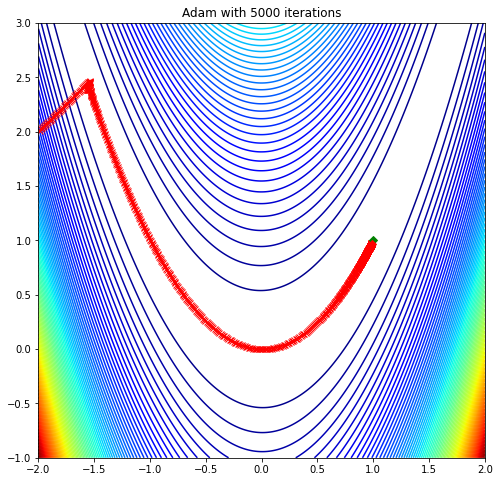

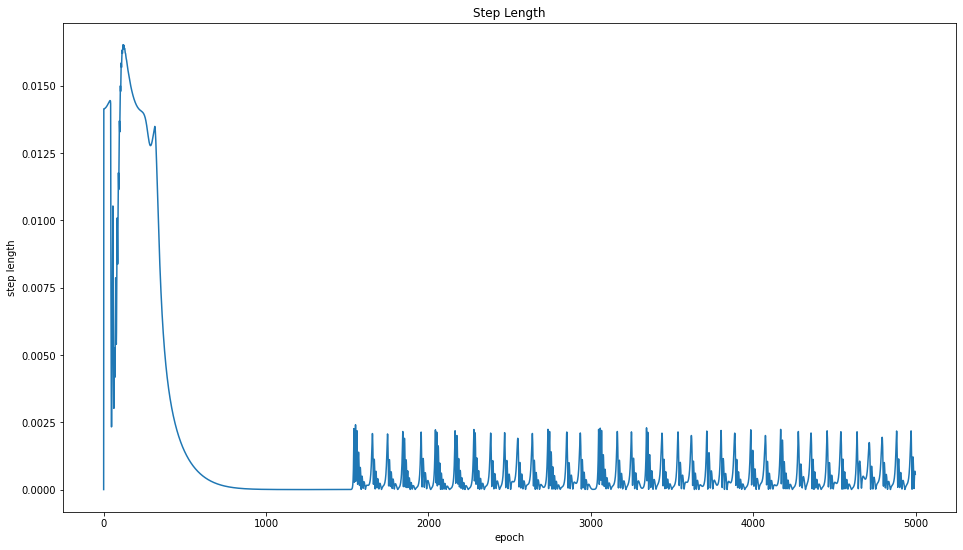

LR: 0.01 | betas: (0.9, 0.999) | weight_decay: 0.001


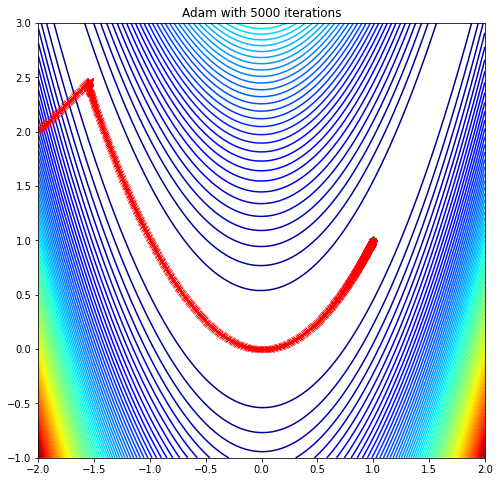

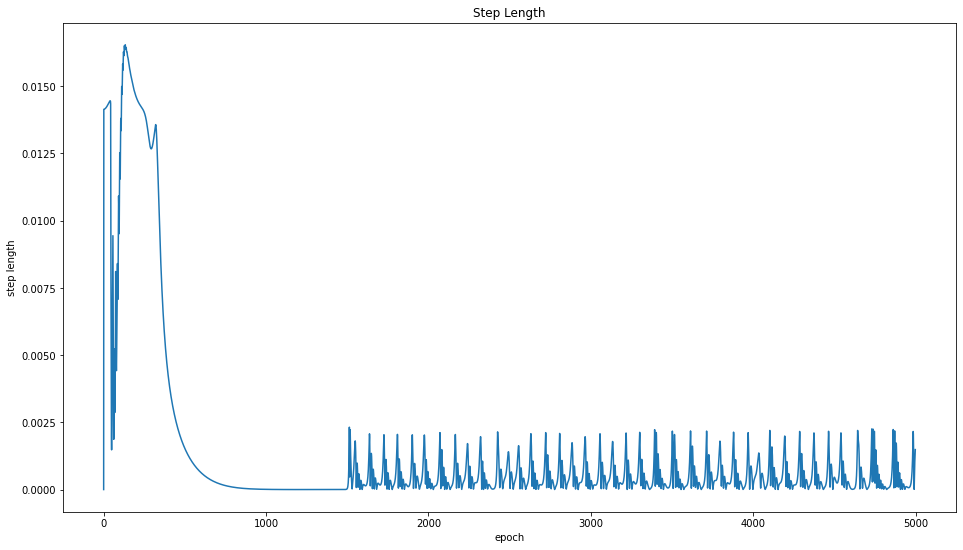

LR: 0.1 | betas: (0.9, 0.999) | weight_decay: 0.01


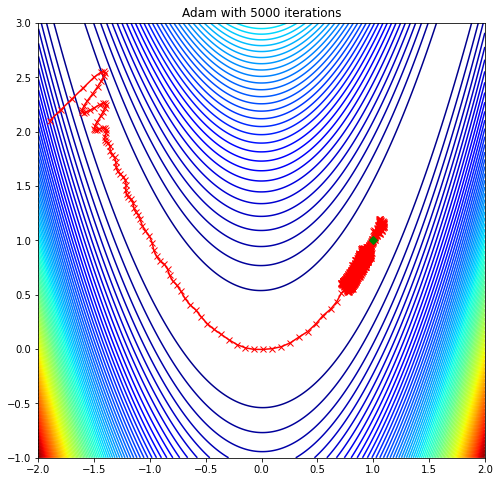

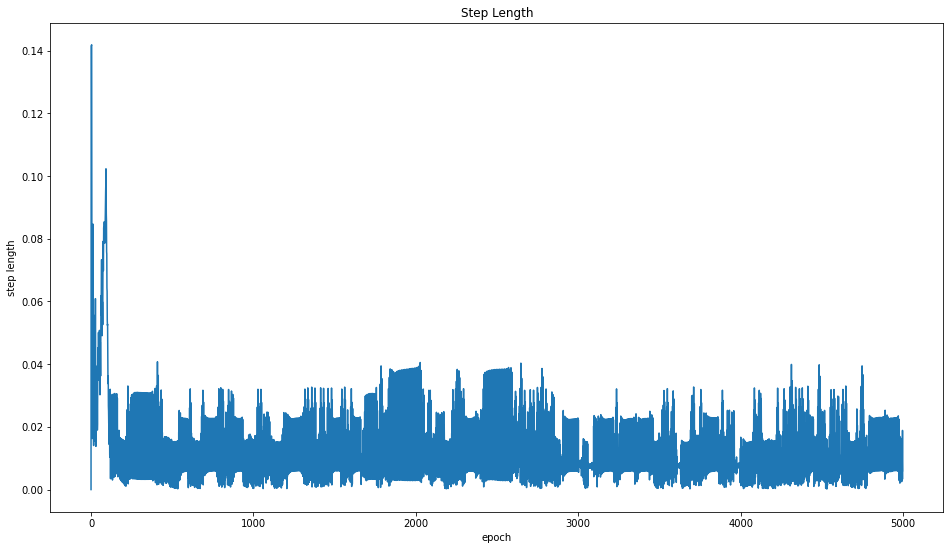

LR: 0.1 | betas: (0.9, 0.999) | weight_decay: 0.001


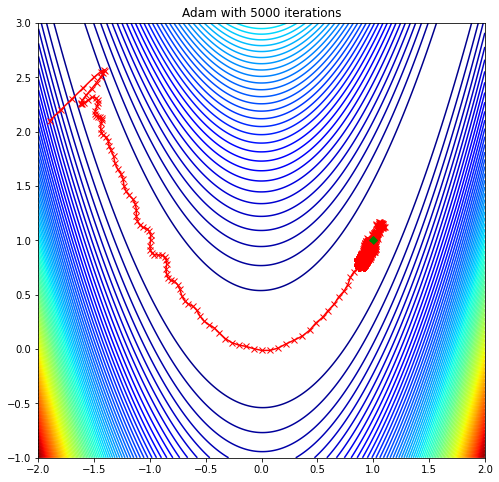

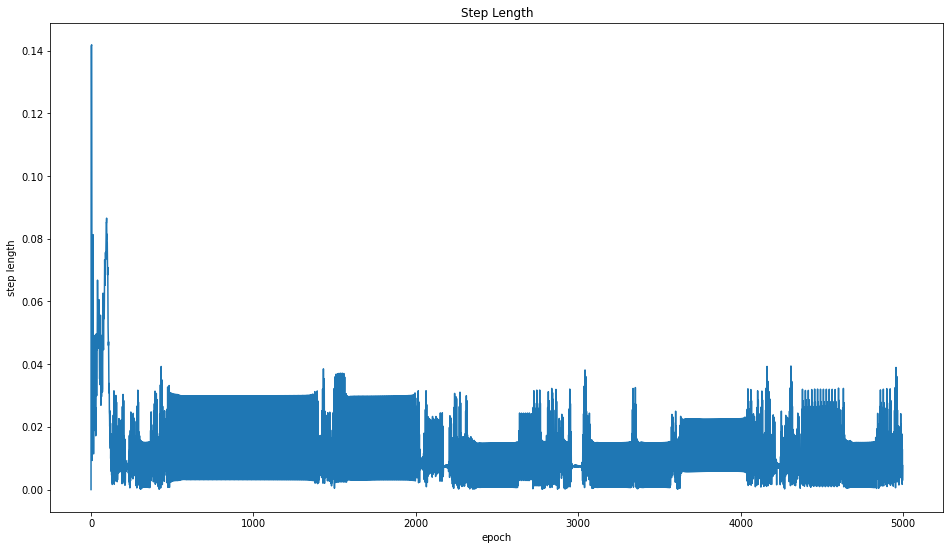

LR: 0.5 | betas: (0.9, 0.999) | weight_decay: 0.01


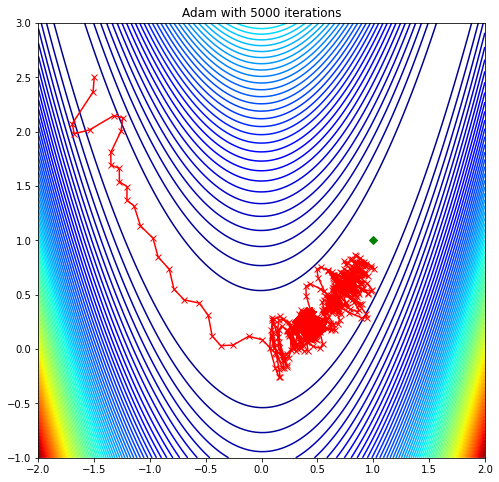

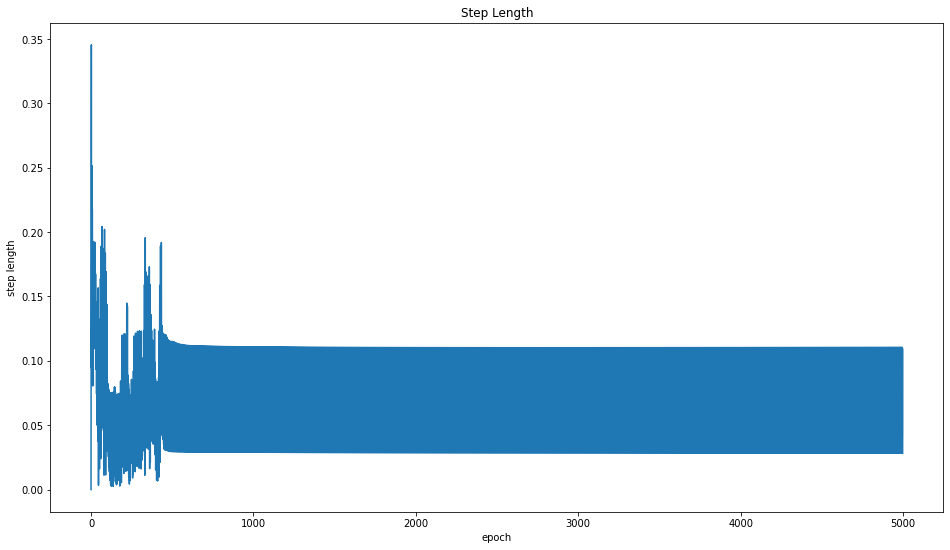

LR: 0.5 | betas: (0.9, 0.999) | weight_decay: 0.001


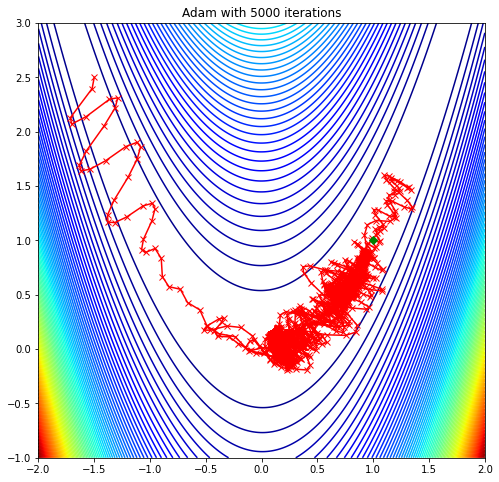

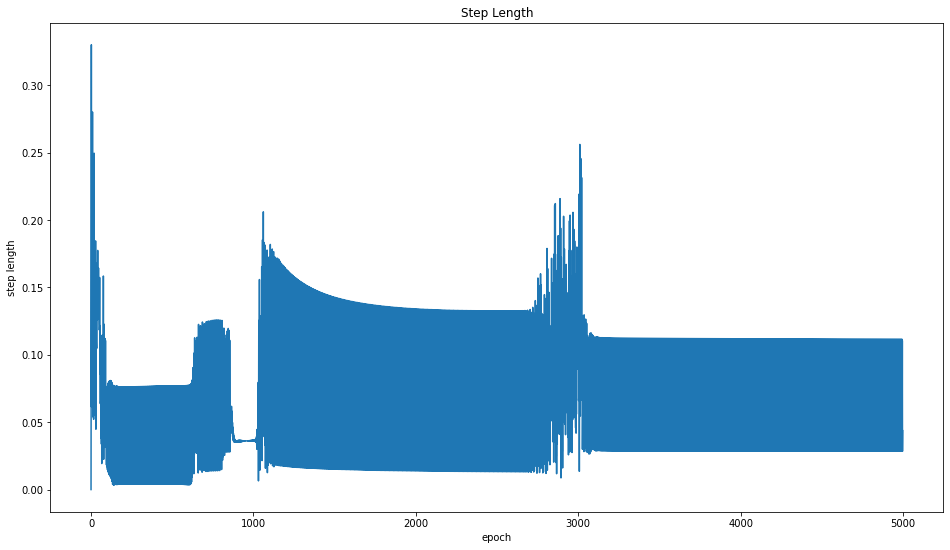

LR: 1 | betas: (0.9, 0.999) | weight_decay: 0.01


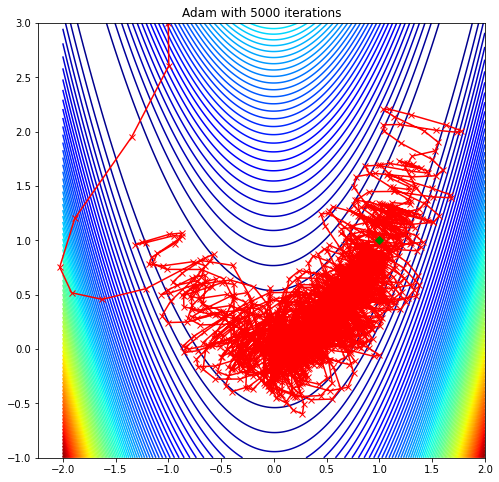

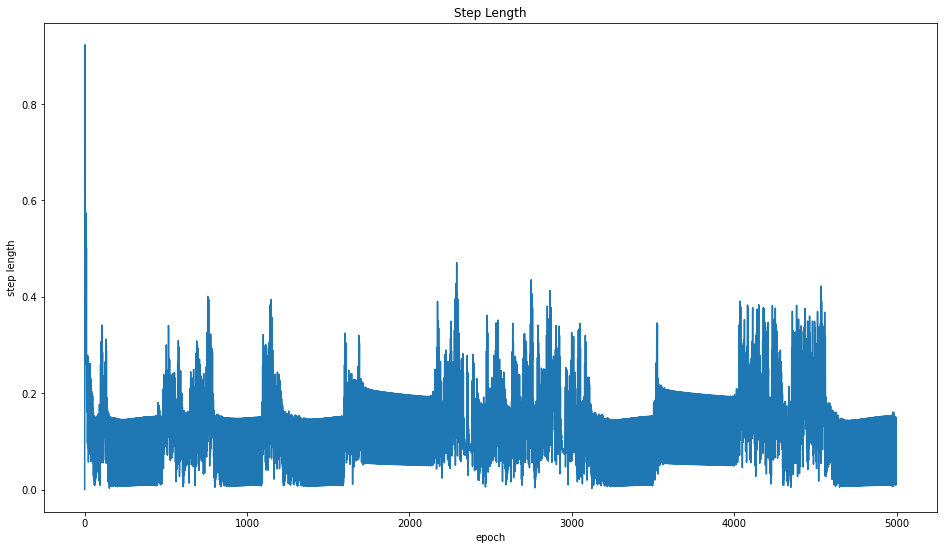

LR: 1 | betas: (0.9, 0.999) | weight_decay: 0.001


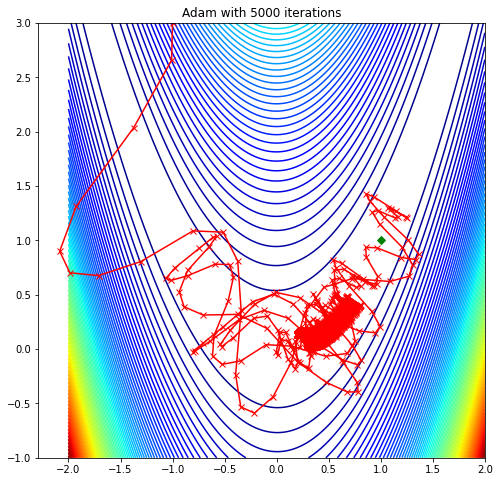

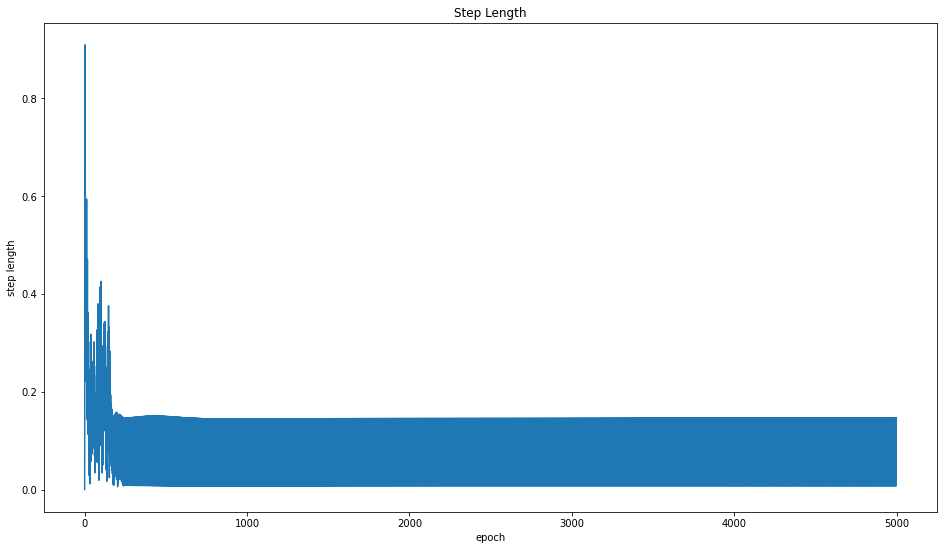

In [10]:
initial_state = np.array([-2,2])
# Try other optimizers!
optimizer_class = torch.optim.Adam
tol=1e-2
for lr in [0.01, 0.1, 0.5, 1]:
  for betas in [(0.9, 0.999)]:
    for weight_decay in [0.01, 0.001]:
      print(f"LR: {lr} | betas: {betas} | weight_decay: {weight_decay}")
      steps = execute_steps(
              rosenbrock,
              initial_state,
              optimizer_class,
              # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
              {'lr': lr, 'betas': betas, 'eps': 1e-08, 'weight_decay': weight_decay, 'amsgrad': False},
              num_iter=5000,
          )
      plot_rosenbrok(steps, optimizer_class.__name__)
      draw_step_len(compute_step_len(steps))

# Learning Rate Scheduler

In [11]:
from torch.optim.lr_scheduler import ExponentialLR, CyclicLR

# ExponentialLR Scheduler

OPTIM - LR: 0.3 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.99


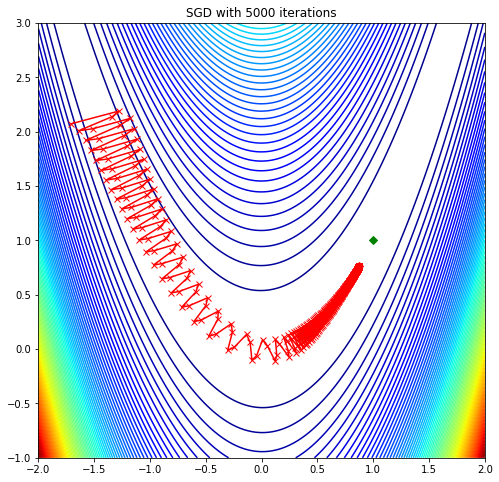

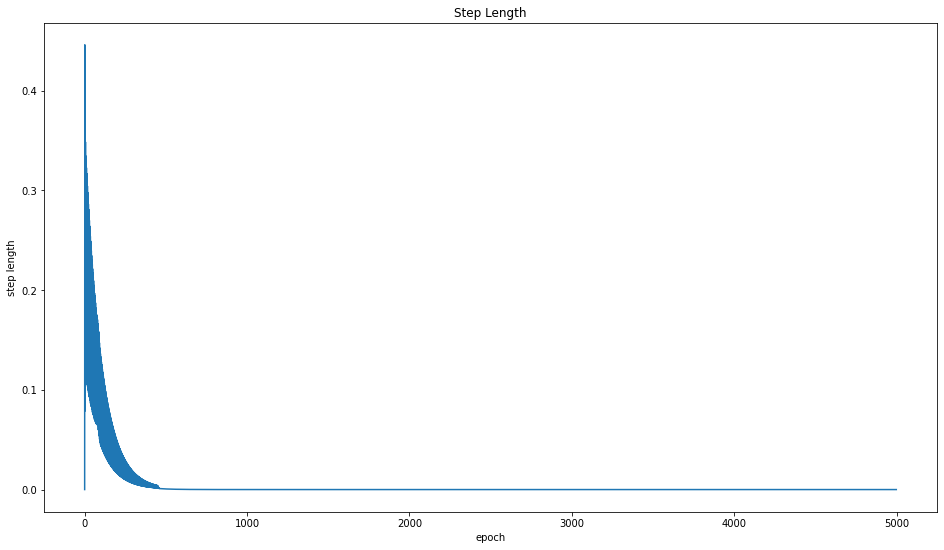

OPTIM - LR: 0.3 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.999


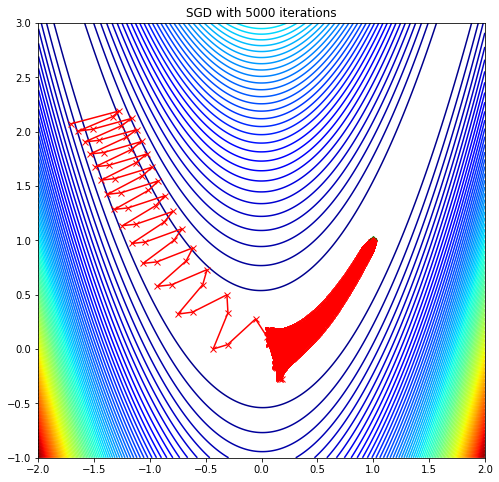

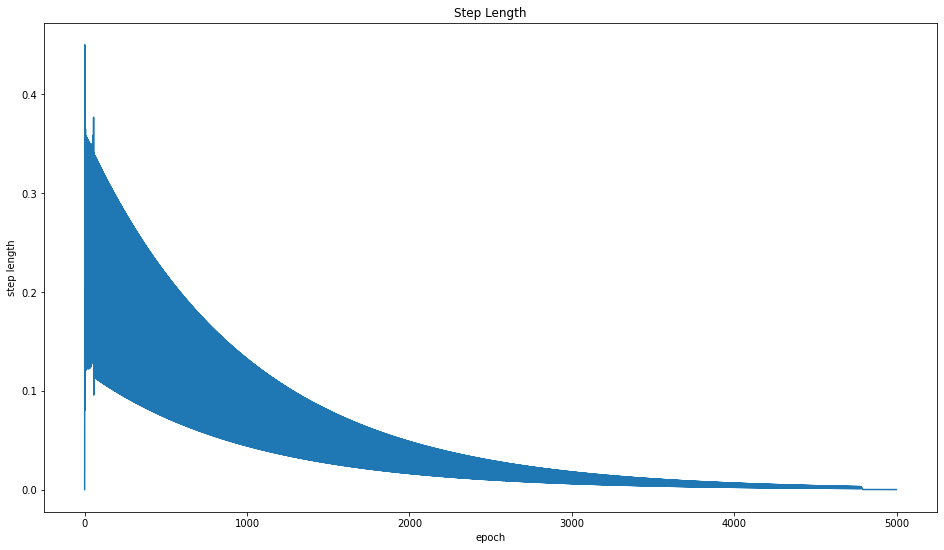

OPTIM - LR: 0.3 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.9999


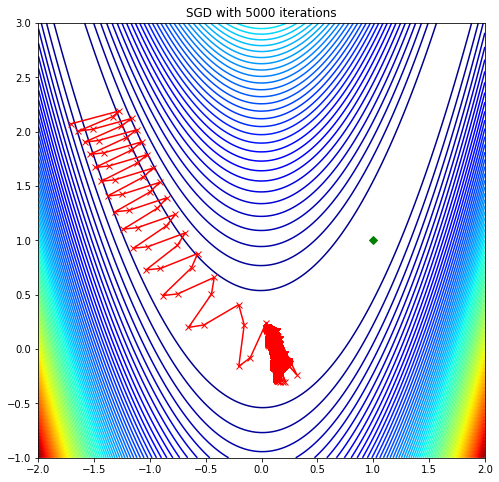

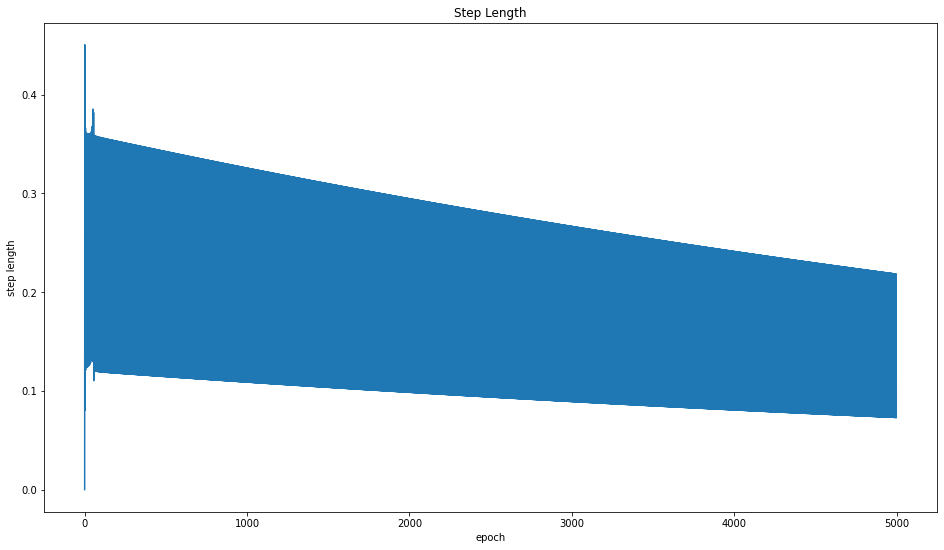

OPTIM - LR: 0.5 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.99


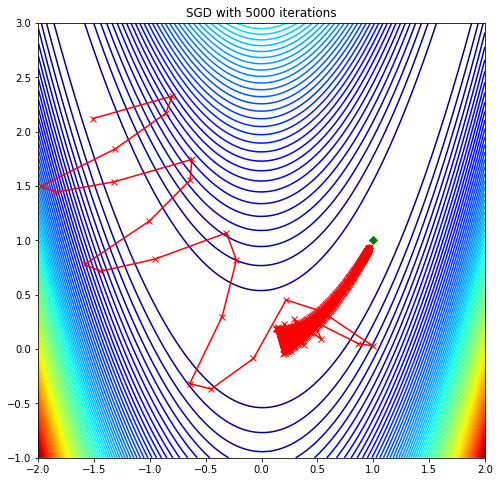

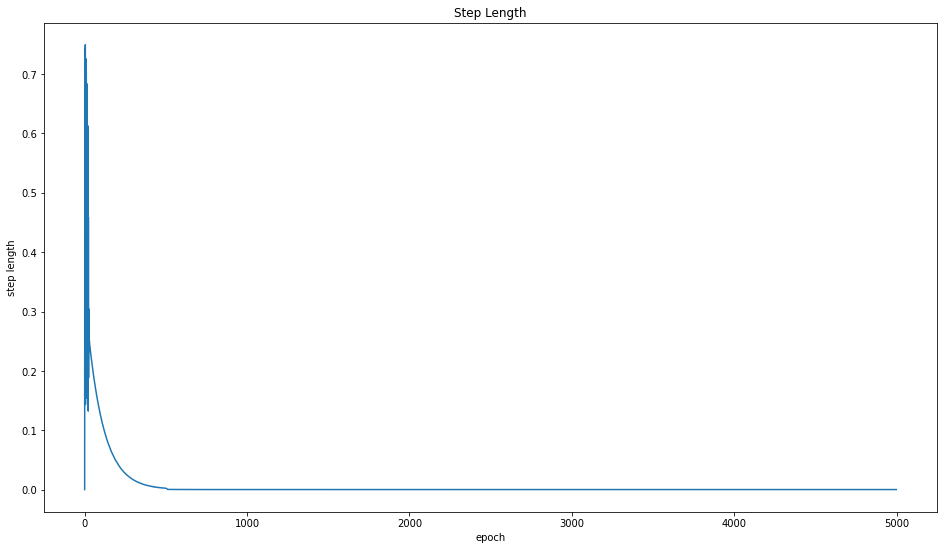

OPTIM - LR: 0.5 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.999


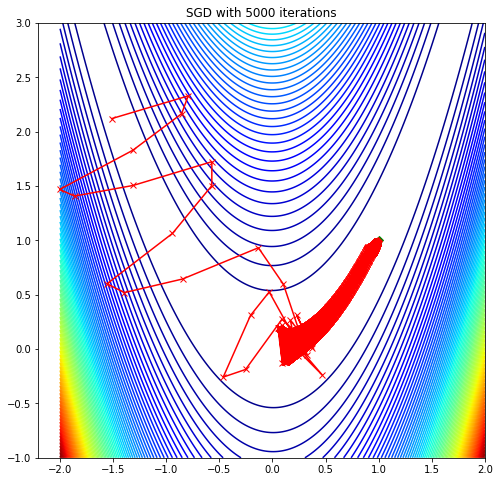

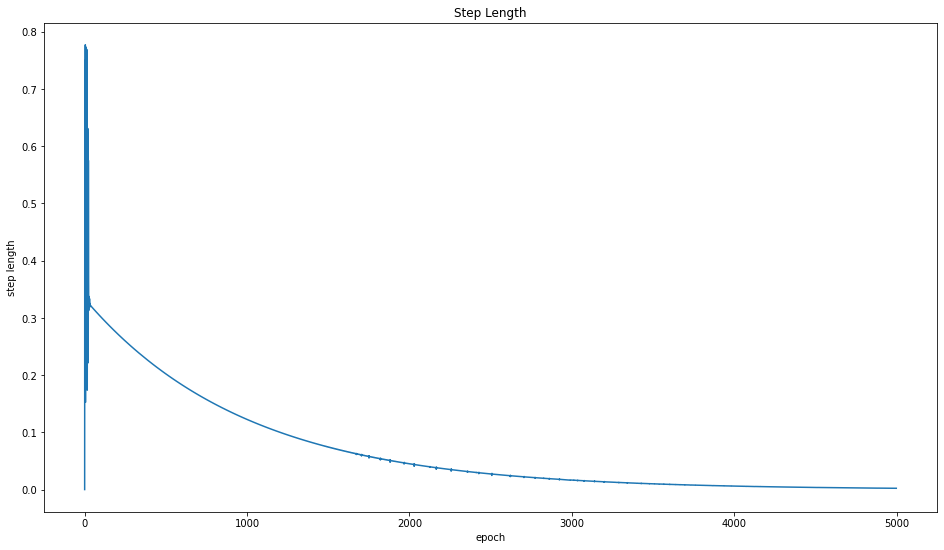

OPTIM - LR: 0.5 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.9999


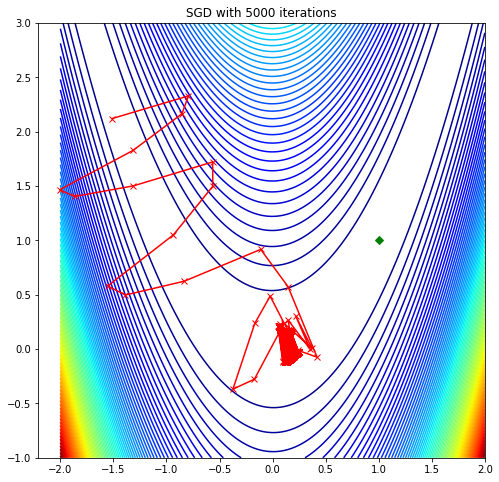

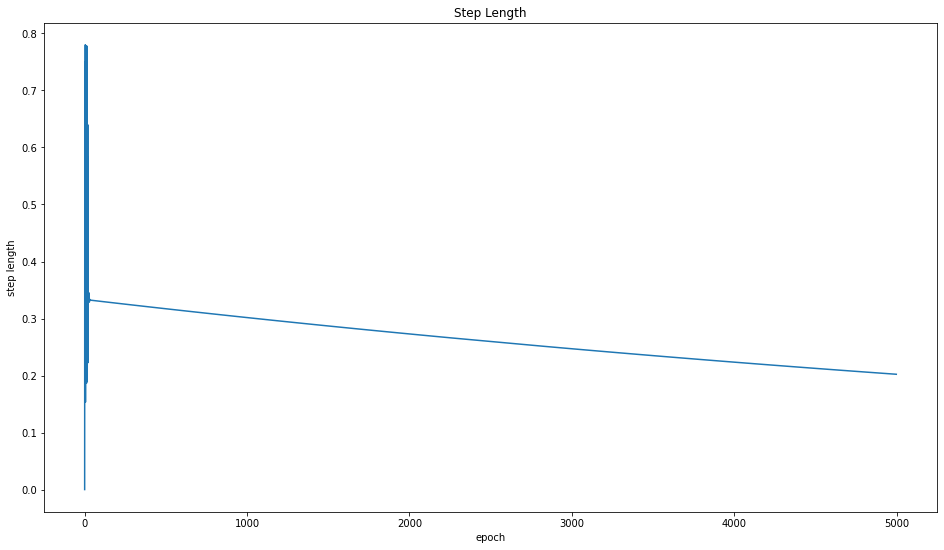

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.99


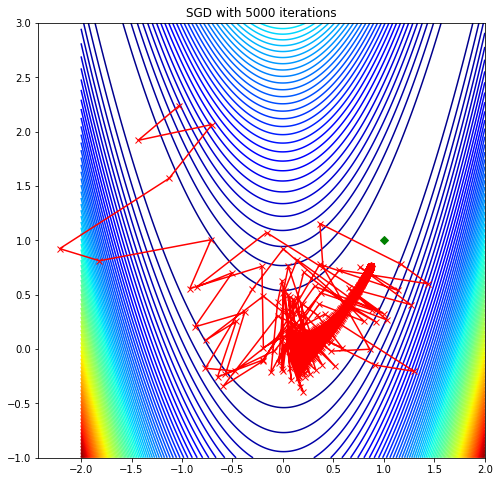

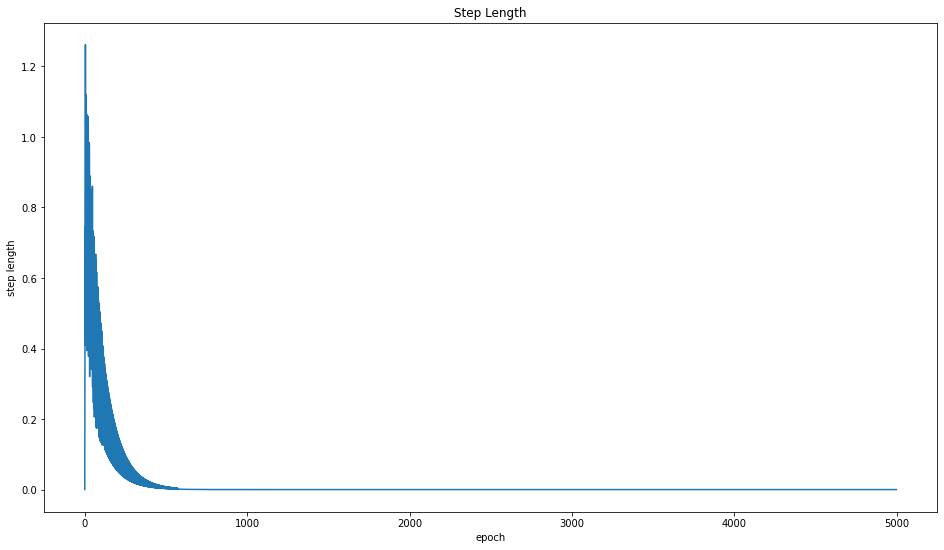

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.999


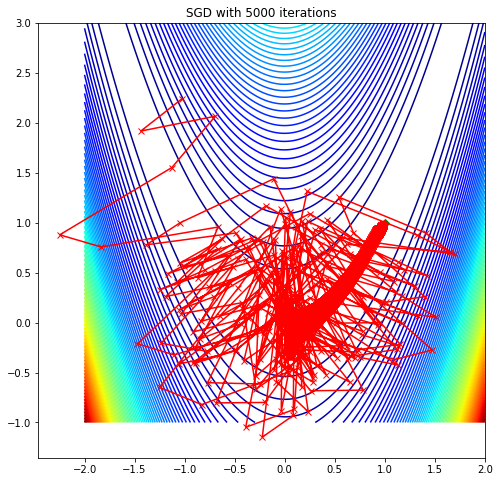

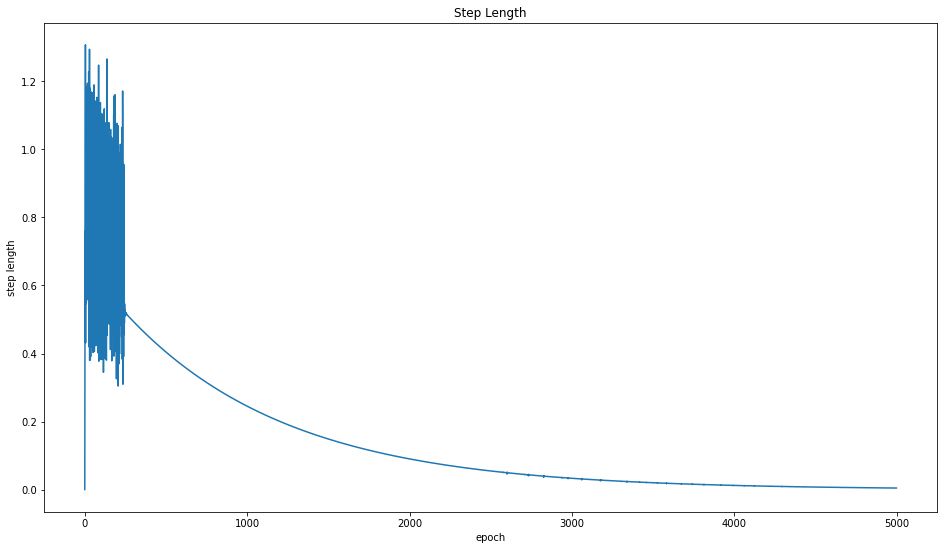

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - gamma: 0.9999


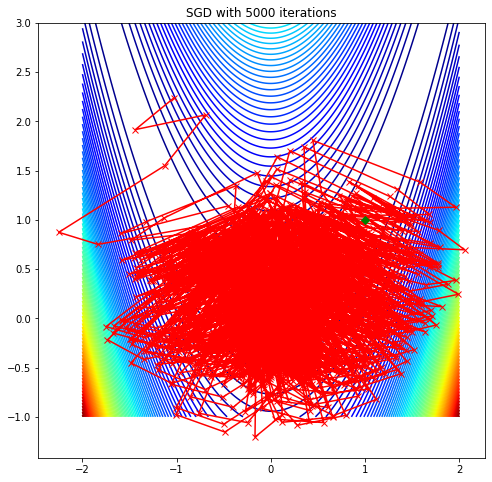

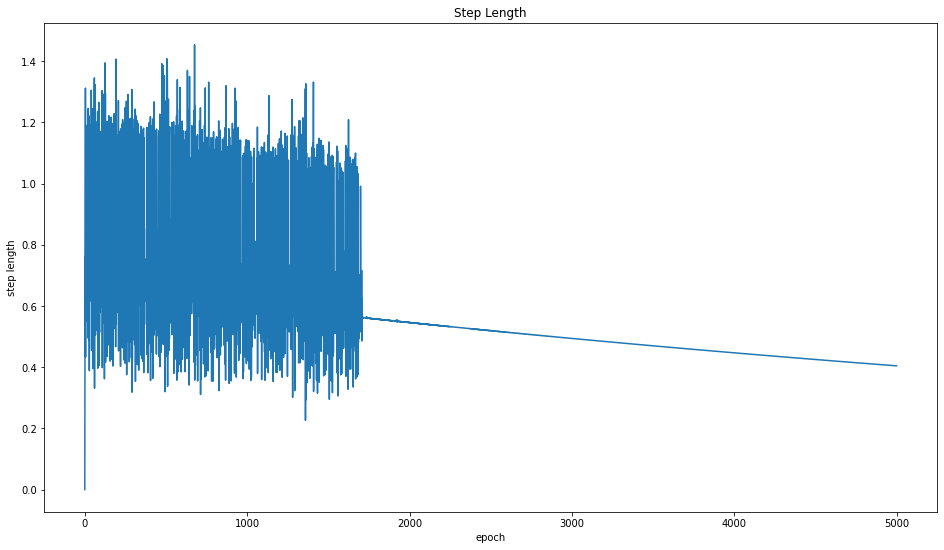

In [12]:
optimizer_class = torch.optim.SGD
scheduler_class = ExponentialLR

for lr in [0.3, 0.5, 1]:
  for momentum in [0.5]:
    for weight_decay in [0.001]:
      for gamma in [0.99, 0.999, 0.9999]:
        print(f"OPTIM - LR: {lr} | momentum: {momentum} | weight_decay: {weight_decay}; SCHEDULER - gamma: {gamma}")
        steps = execute_steps(
                rosenbrock,
                initial_state,
                optimizer_class,
                # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
                {'lr':lr, 'momentum':momentum, 'weight_decay':weight_decay},
                scheduler_class,
                {'gamma':gamma},
                num_iter=5000,
            )
        plot_rosenbrok(steps, optimizer_class.__name__)
        draw_step_len(compute_step_len(steps))

# CyclicLR Scheduler

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - mode: triangular | gamma: 1 | base_lr: 0.01 | max_lr: 0.1


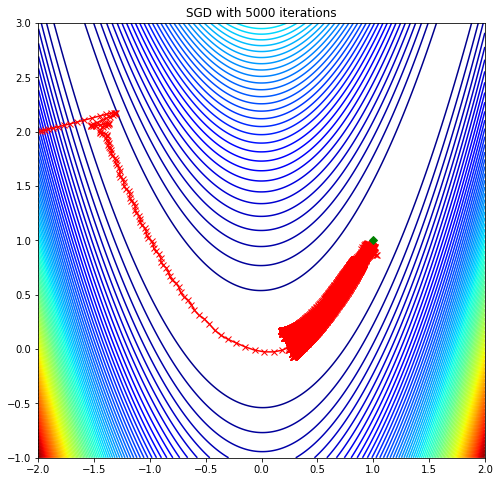

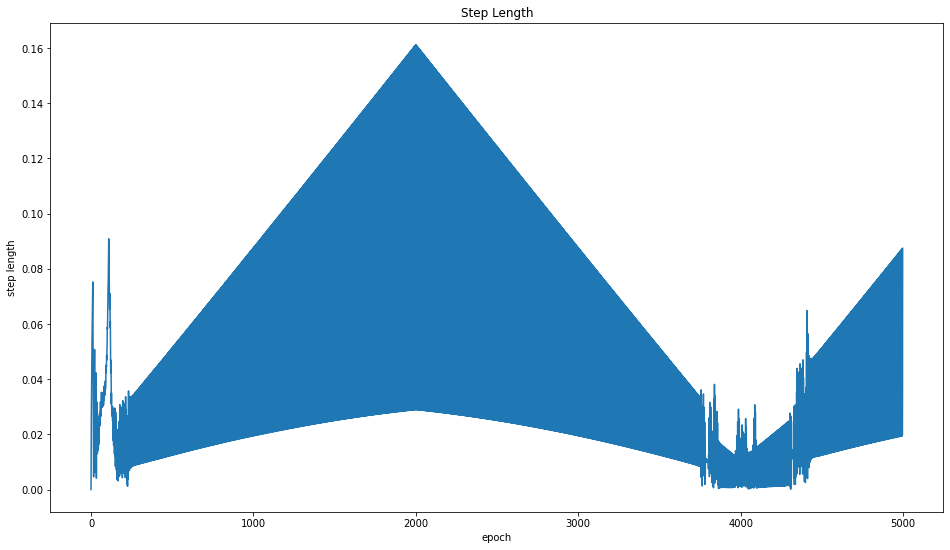

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - mode: triangular | gamma: 1 | base_lr: 0.01 | max_lr: 0.3


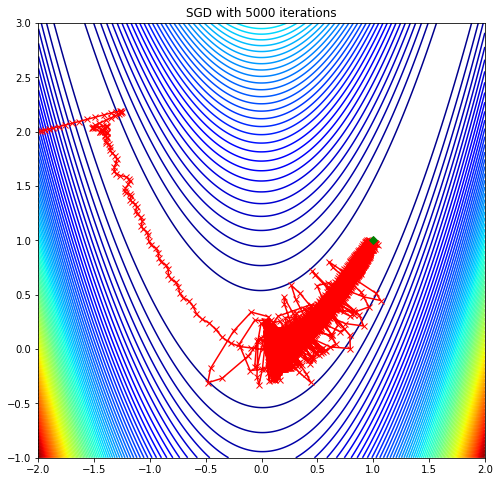

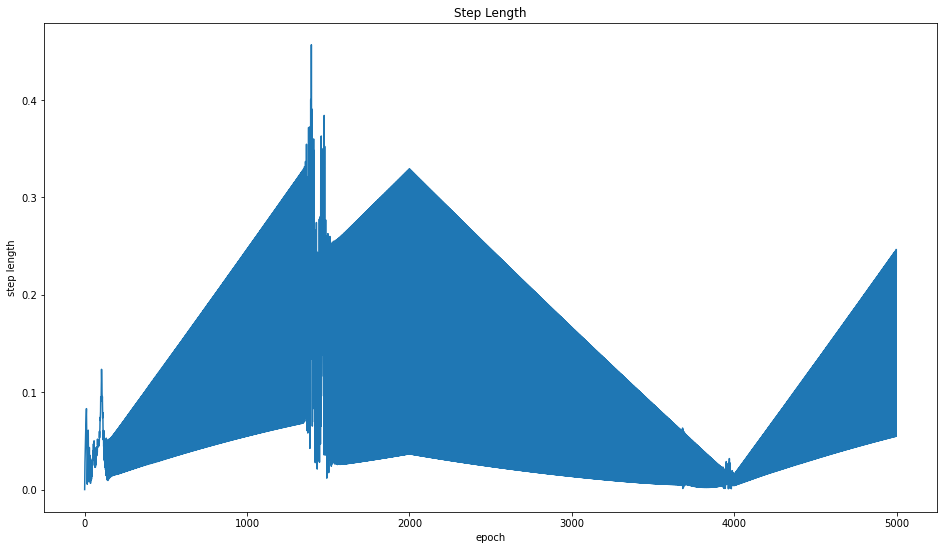

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - mode: triangular | gamma: 1 | base_lr: 0.01 | max_lr: 0.5


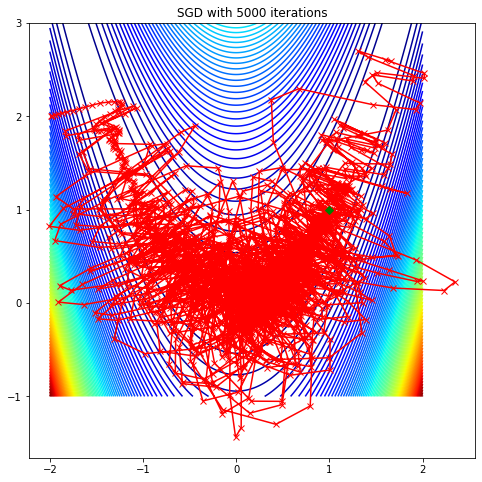

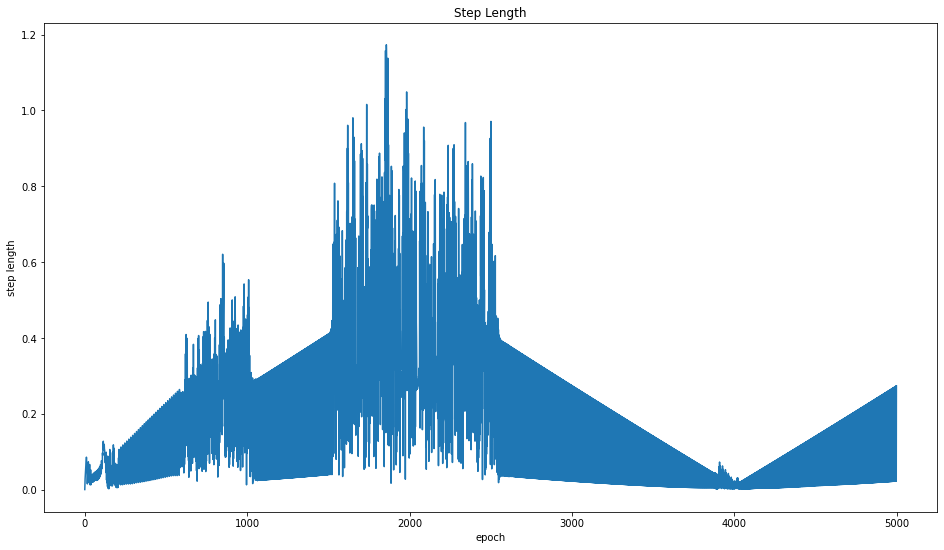

In [13]:
optimizer_class = torch.optim.SGD
scheduler_class = CyclicLR

for lr in [1]:
  for momentum in [0.5]:
    for weight_decay in [0.001]:
      for gamma in [1]:
        for sched_lr in [(0.01, 0.1), (0.01, 0.3), (0.01, 0.5)]:
          print(f"OPTIM - LR: {lr} | momentum: {momentum} | weight_decay: {weight_decay}; SCHEDULER - mode: triangular | gamma: {gamma} | base_lr: {sched_lr[0]} | max_lr: {sched_lr[1]}")
          steps = execute_steps(
                  rosenbrock,
                  initial_state,
                  optimizer_class,
                  # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
                  {'lr':lr, 'momentum':momentum, 'weight_decay':weight_decay},
                  scheduler_class,
                  {'gamma': gamma, 'base_lr': sched_lr[0], 'max_lr': sched_lr[1]},
                  num_iter=5000,
              )
          plot_rosenbrok(steps, optimizer_class.__name__)
          draw_step_len(compute_step_len(steps))

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - mode: triangular2 | gamma: 1 | base_lr: 0.01 | max_lr: 0.1


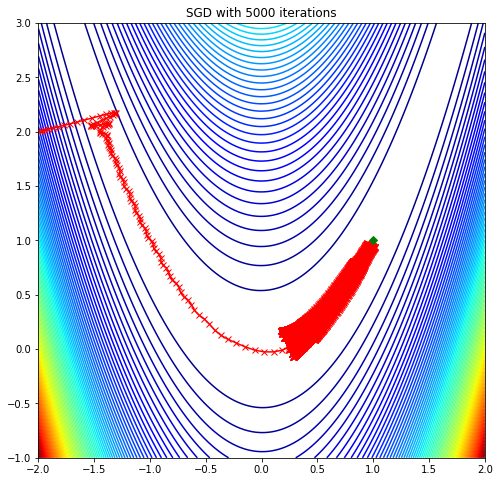

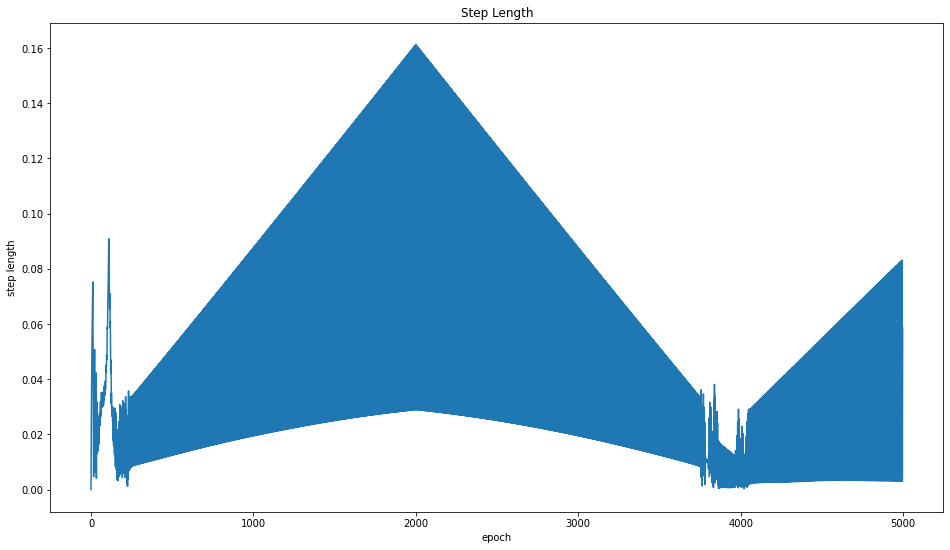

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - mode: triangular2 | gamma: 1 | base_lr: 0.01 | max_lr: 0.3


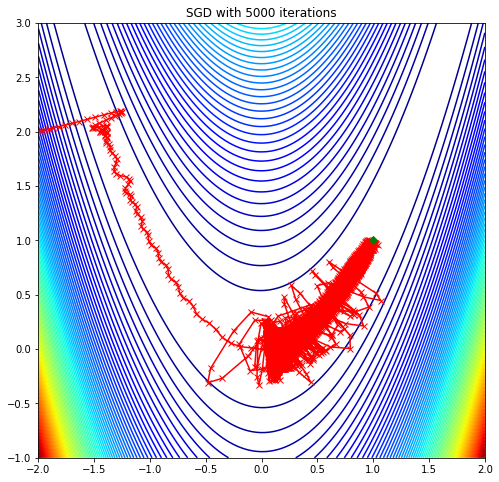

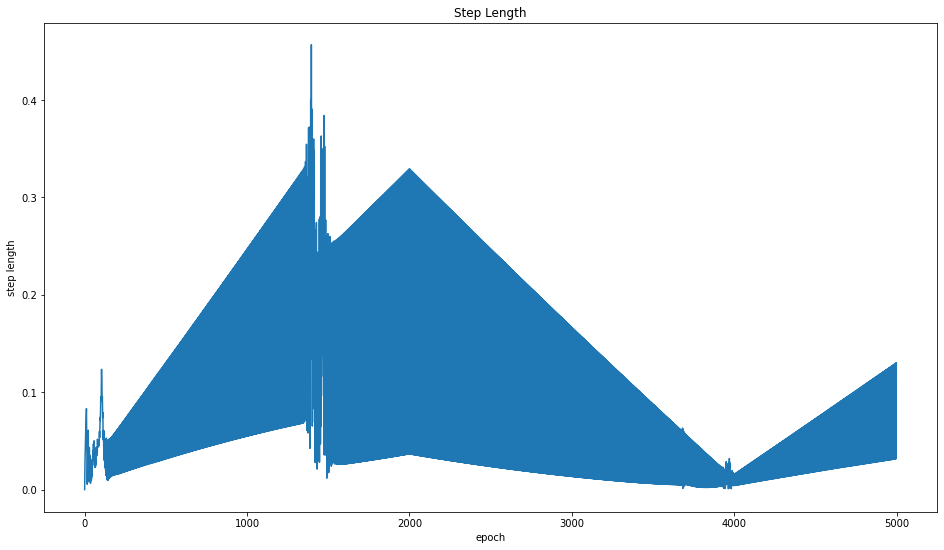

OPTIM - LR: 1 | momentum: 0.5 | weight_decay: 0.001; SCHEDULER - mode: triangular2 | gamma: 1 | base_lr: 0.01 | max_lr: 0.5


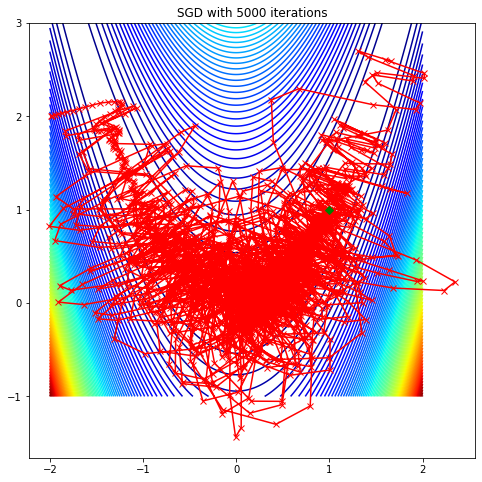

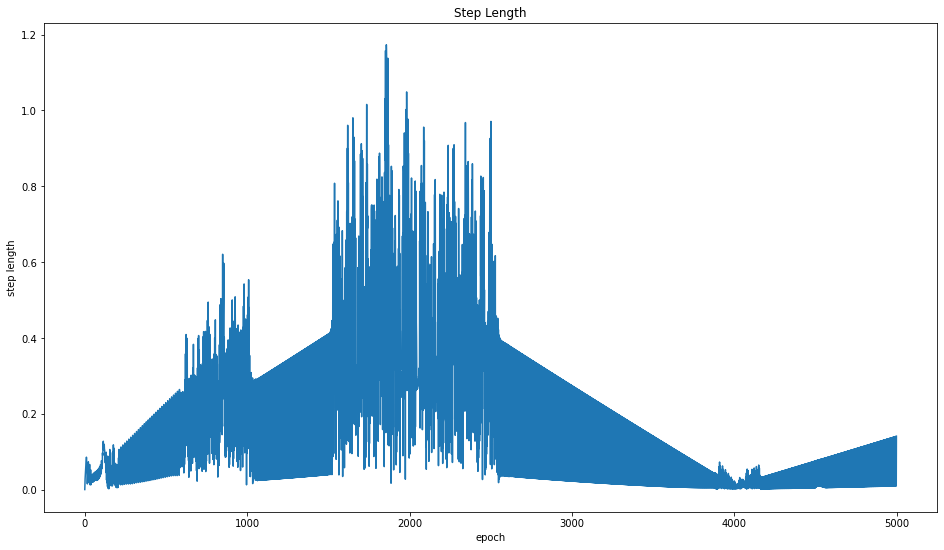

In [14]:
optimizer_class = torch.optim.SGD
scheduler_class = CyclicLR

for lr in [1]:
  for momentum in [0.5]:
    for weight_decay in [0.001]:
      for gamma in [1]:
        for sched_lr in [(0.01, 0.1), (0.01, 0.3), (0.01, 0.5)]:
          print(f"OPTIM - LR: {lr} | momentum: {momentum} | weight_decay: {weight_decay}; SCHEDULER - mode: triangular2 | gamma: {gamma} | base_lr: {sched_lr[0]} | max_lr: {sched_lr[1]}")
          steps = execute_steps(
                  rosenbrock,
                  initial_state,
                  optimizer_class,
                  # Try some different hyperparameters! Note that these parameters should be wraped in a dict().
                  {'lr':lr, 'momentum':momentum, 'weight_decay':weight_decay},
                  scheduler_class,
                  {'gamma': gamma, 'base_lr': sched_lr[0], 'max_lr': sched_lr[1], 'mode': 'triangular2'},
                  num_iter=5000,
              )
          plot_rosenbrok(steps, optimizer_class.__name__)
          draw_step_len(compute_step_len(steps))

## Report

# Optimizers

## SGD

SGD samples a batch of training data to approximate the gradient and update the model in each iteration, which has much faster covergence than GD and cheaper computation cost. However, SGD may get a approximated gradient and cause the wrong descent direction. In my experiment, we can see that SGD may dumping around the mimimum point and cannot reach the optimal. Also, due to the stochasticity of SGD, SGD can only gurantee the convergence in probability which means it may reach different destination even the hyperparameters are the same.

1. While learning rate = 0.01

  - Momentum, Weight Decay: Almost no effect

2. While learning rate = 0.1

  - If the weight decay is too large, the optimizer would stop before reaching the destination.
  - I observe taht the momentum can enlarge the step size for each iteration. If the momentum is too large, it would jump too far from the proper trajectory. 

3. While learning rate = 0.5, 1

 - Learning rate is too large.

## LBFGS

No matter how large the learning rate is, LBFGS always converges well. With larger learning rate, the step length gets larger and LBFGS can converge fatser.

# AdaGrad

If the learning rate is too large, it would jump too far and escape from the proper trajectory(zig-zag). I also observe that the weight decay almost doesn't affect the trajectory.

1. While learning rate = 0.01, 0.1, 0.5
  - Converge well

2. While learning rate = 1

  - The learning rate is too large and it would jump too far and escape from the proper trajectory(zig-zag)

## RMSProp

1. While learning rate = 0.01

  - Converge well

2. While learning rate = 0.1

  - Weight Decay = 0.01:

  - Weight Decay = 0.001: Stop earlier than the previous one. It's perhaps caused by the small gradient at the plain and the small weight decay. The gradient isn't large enough to move forward.

## Adam

1. While learning rate = 0.01, 0.1

  - Converge well

2. While learning rate = 0.5

  - If the weight decay is too large, the optimizer would stop before reaching the destination.

3. While learning rate = 1

  - If the learning rate is too large, it would jump too far and escape from the proper trajectory(zig-zag)

# Learning Rate Scheduler

Use SGD as the optimizer.

## ExponentialLR Scheduler

``ExponentialLR`` decays the learning rate exponetially at each iteration.

With the help of ExponentialLR, the learning rate decays along the increasing iteration and converge to the destination faster

1. While learning rate = 0.5, 1

  - Originally, SGD cannot converge to the destination without ExponentialLR. 
  - ExponentialLR makes the learning rate decrease exponentially and converge to destination.

2. While learning rate = 0.01, 0.1

  - The learning rate is too small and the optimizer stop befroe reaching the destination.

## CyclicLR Scheduler

### Mode: triangular

``CyclicLR`` increases and decrease the learning rate periodically like the following figure.

![](https://github.com/bckenstler/CLR/raw/master/images/triangularDiag.png?raw=true)

1. While learning rate(base_lr, max_lr) = (0.01, 0.1), (0.01, 0.3)

  - The optimizer can converge but it would damp severly at max_lr=0.3

  - It seems that it doesn't provide faster convergence.

2. While learning rate = (0.01, 0.5)

  - The learning rate is too large and jump out from the proper trajectory.

### Mode: triangular2

![](https://github.com/bckenstler/CLR/raw/master/images/triangular2Diag.png?raw=true)

1. Seems no difference to mode=triangular.

# Reference

- [加速PyTorch模型訓練技巧](https://hackmd.io/@Hong-Jia/H1hmbNr1d#3-lr_schedulerExponentialLR)
- [Regularization 方法 : Weight Decay , Early Stopping and Dropout](https://hackmd.io/@allen108108/Bkp-RGfCE)
- [Github - bckenstler/CLR](https://github.com/bckenstler/CLR)